<center> <h1>FoodML Report</h1> </center>

## Table of contents
1. [Introduction](#introduction)
2. [Input data description](#data_description)
3. [Imports](#imports)
4. [Data preprocessing](#data_preprocessing)
    1. [Color spaces](#color_spaces)
    2. [Feature Extraction Module](#feature_extraction_module)
    3. [Histograms extraction](#histograms_extraction)
    4. [Pixel blocks](#pixel_blocks)
    5. [Clusters](#clusters)
    6. [Raw pixels](#raw_pixels)
    7. [Preprocessing dataframe](#preprocessing_dataframe)
5. [Classification](#classification)
    1. [Classification module](#classification_module)
    2. [Dimensionality reduction](#dimensionality_reduction)
    3. [Best model selection](#best_model_selection)
    4. [Results discussion](#results_discussion)
6. [Future work](#future_work)
6. [References](#references)

## Introduction <a name="introduction"></a>

The purpose of the project is to find model classyfing food products basing on pictures. Dataset used for training and validation of models is composed of two datasets: [FooDD](#foodd) and [ECUSTFD](#ecustfd).
In order to enhance classifiers performance, set of operations is run on each picture in order to create features which can be useful for classification. As a result of preprocessing step, dataset with features is composed.
Features dataset is splitted to training and validation datasets and transformed in oreder to reduce dimensions.
Finally, set of classifiers is run on dataset with different parameters. Results of classifiers are compared the most suitable one is chosen.

## Input data description <a name="data_description"></a>
Originally pictures used from training come from FooDD and ECUSTFD datasets. All the pictures are contained in one directory with subdirectories containing pictures for each class. Pictures containing multiple food products have been divided into pictures of singular products. Objects from those pictures have been extraced with usage of object detection algorithm from [ImageAI](#imgai) library.
ML_inputDF is dataframe containing paths of every picture and class of item presented on it. In order to balance data, each class which had less than 15 records has been deleted. Pictures of every class with more than 15 and less than 250 records have been duplicated with rotation and addition of gaussian noise so that every class has at least 250 items. Such an dataframe is provided as input for features extraction module.

## Imports <a name="imports"></a>
Necessary imports:

In [254]:
import pandas as pd
import numpy as np
import seaborn as sns
from matplotlib import pyplot as plt
from scipy.stats import uniform
from scipy.stats import expon
from sklearn.pipeline import Pipeline, make_pipeline
from sklearn.feature_selection import VarianceThreshold
from sklearn.preprocessing import StandardScaler
import dill
import pickle
import random
from IPython.display import display
from IPython.core.display import HTML
from sklearn.feature_selection import VarianceThreshold
from sklearn.metrics import make_scorer
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import log_loss
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis, QuadraticDiscriminantAnalysis
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.svm import SVC
from sklearn.decomposition import PCA
from sklearn.naive_bayes import BernoulliNB, MultinomialNB, GaussianNB
from sklearn.neural_network import MLPClassifier
from xgboost import XGBClassifier
%load_ext autoreload
%autoreload 2
import classification_module as classmod
import features_extraction_funcs as feex
import feats_extr_module as feex_module
%aimport

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload
Modules to reload:
all-except-skipped

Modules to skip:



## Data preprocessing <a name="data_preprocessing"></a>

### Color spaces <a name="color_spaces"></a>
In order to exctract as much infomration as possible, feature extraction is run four times on each picture, for following colorspaces: RGB, HSV, CIE and YdBdR. Reasoning behind such a solution is that different color spaces make different aspects of image more visible:
* RGB - original color space of images, channels represent red, green and blue colors.
* HSV - Hue, Saturation, Value. This colorspace is often better for discriminating objects than RGB beacuse separating hue, saturation and value is often more effective than separating intensity of R, G an B values.
* CIELab - Most popular way of describing color in modern applications. Channels describe lumination, green-magenta ratio and blue-yellow ratio.
* YDbDr - Y stands for luminace, Db represents blue color and Dr represents red color.

### Feature Extraction Module <a name="feature_extraction_module"></a>
In below part of script, input dataframe will be used to extract features for each record.
This process is realised by functions defined in "features_extraction_funcs.py" and "feats_extr_module.py" files.

Functions implementing extraction are listed below:

```python
def extract_feats_from_pickle(input_path, output_path, join_cols = [], label_column='ProdName'):
    in_DF = pd.read_pickle(input_path)
    feats_DF = feex.extractVarsForML(in_DF)
    feats_DF = pd.concat([feats_DF, in_DF[join_cols], in_DF[label_column]], axis=1)
    feats_DF.to_pickle(output_path)
    return feats_DF

def split_dataset(feats_DF,label_column='ProdName',cols_to_drop=[], test_size = 0.2,
                  random_state = 666):
    y = feats_DF[label_column]
    X = feats_DF.drop([label_column],axis=1)
    X = X.drop(cols_to_drop,axis=1)
    return train_test_split(X, y, test_size, random_state)
    
def prepareTrainingData(output_path, input_path='', label_column='ProdName', join_cols = [], extract=False):
    if extract:
        feats_DF = extract_feats_from_pickle(input_path, output_path, label_column)
    else:
        feats_DF = pd.read_pickle(output_path)
    return split_dataset(feats_DF,label_column)
```
```python
def describeImgs(df,cspace,bins=50,blocksResiz=160,blocksblSiz=20,n_clusters=5,clustResiz=3,
                 new_width=32,new_height=32):
    '''Extract features for records in dataframe
    '''

    #Extract histograms
    histV,histCols = genHistArrays(df,cspace,bins)
    histDF = pd.DataFrame(data = histV, columns = histCols)

    #Extract pixel blocks
    blocksV, blocksCols = blocksVals(df,blocksblSiz,blocksResiz, cspace)
    blocksDF = pd.DataFrame(data = blocksV, columns = blocksCols)

    #Extract clusters
    segV, segCols = getSegmentInfo(df,cspace,n_clusters, clustResiz)
    segDF = pd.DataFrame(data = segV, columns = segCols)

    #Extract raw pixels
    rawPicsV, rawPixCols = addRawPixValsImgDf(df,cspace,new_width,new_height)
    rawPicsDF = pd.DataFrame(data = rawPicsV, columns = rawPixCols)

    #Concatenate features
    return pd.concat([histDF,blocksDF,segDF,rawPicsDF], axis=1)

def extractVarsForML(df,bins=50,blocksResiz=160,blocksblSiz=20,n_clusters=5,clustResiz=3,new_width=32,new_height=32):
    '''Extract features for RGB, HSV, CIE and YdBdR'''
    resDF = describeImgs(df,'RGB',bins,blocksResiz,blocksblSiz,
                         n_clusters,clustResiz,new_width,new_height)
    cspdict = {'HSV': cl.rgb2hsv, 'CIE': cl.rgb2rgbcie, 'YDBDR': cl.rgb2ydbdr}
    for csp, colFunc in cspdict.items():
        df['SKImage'] = df['SKImage'].apply(colFunc)
        resDF = pd.concat([resDF, describeImgs(df,csp,bins,blocksResiz,
                                               blocksblSiz,n_clusters,clustResiz,
                                               new_width,new_height)], axis=1)
    return resDF
```

### Histograms extraction <a name="histograms_extraction"></a>
Histograms extraction functions:
```python
def getHists(img,bins=50):
    """Generate histogram containing <bins> amount of bins. 
    
    i-th value represents density of pixels with values contained in i-th bin
    """
    hists = np.array([])
    for i in range(3):#Images are loaded as three-dimensional matrices with three channels
        hists = np.append(hists,np.histogram(img[:,:,i], bins, density = True)[0])
    return hists

def genHistArrays(df,csname,bins=50):
    """Create pixels' color histograms for every row in df
    
    df - input dataframe
    csname - color space (RGB, HSV, CIE or YdBdR)
    bins - specifies how many bins should be in histogram for each color channel
    """
    #initiate matrix which will contain values of histograms
    allpixV = np.zeros((df.shape[0],bins*3))
    #attain histograms
    hists = df['SKImage'].apply(lambda x: getHists(x,bins))
    
    #Generate column names for result dataframe
    fullnames = []
    for chs in ['CH1', 'CH2', 'CH3']:
        fullnames.extend([chs+'-'+str(j) for j in range(bins)])
    fullnames = [csname+'-'+str(j) for j in fullnames]
    
    #extract histograms
    for rowi, histArr in enumerate(hists):
        allpixV[rowi,:] = np.array(histArr).flatten()
        
    return allpixV,fullnames
```

### Pixel blocks <a name="pixel_blocks"></a>
Splitting image into blocks:
```python
def blocksForImg(img,samplsiz,resc):
    """Split image into blocks of pixels and calculate mean and standard variation of each block
    """
    #scale image into square shape
    imgr = resize(img,(resc,resc,3))

    #create blocks
    view = []
    view.append(view_as_blocks(imgr[:,:,0], (samplsiz,samplsiz)))
    view.append(view_as_blocks(imgr[:,:,1], (samplsiz,samplsiz)))
    view.append(view_as_blocks(imgr[:,:,2], (samplsiz,samplsiz)))

    #calculate mean values and standard deviation for each block
    flv = [v.reshape(v.shape[0],v.shape[1],-1) for v in view]
    meanb = np.array([np.mean(f,axis=2) for f in flv])
    stdb = np.array([np.std(f,axis=2) for f in flv])

    #return vector cancatenated from means, standard deviations, sorted means and sorted deviations
    meanb = meanb.flatten()
    stdb = stdb.flatten()
    meanbsort = np.sort(meanb)
    stdbsort = np.sort(stdb)
    return np.append(meanb,[stdb,meanbsort,stdbsort])

def blocksVals(df,ssiz,resc,cspacename='RGB'):
    """Divide each image in dataframe into set of blocks,
    calculate their mean pixel values and standard deviations and concatenate those values in following manner: [unsorted means, unsorted stds, sorted means, sorted stds]
    """

    #calculate amount of generated blocks
    amountBlocks = np.power(resc/ssiz,2)
    amountBlocks = int(amountBlocks)

    #generate labels for blocks
    labelnames = []
    for ch in ['CH1','CH2','CH3']:   
        labelnames = np.append(labelnames,[
            cspacename+'-Mean-Block: '+ch+' '+str(i) for i in range(1,
                                                              amountBlocks+1)])
        labelnames = np.append(labelnames,[
            cspacename+'-Std-Block: '+ch+' '+str(i) for i in range(1,
                                                             amountBlocks+1)])
        labelnames = np.append(labelnames,[
            cspacename+'-Mean_Sorted-Block: '+ch+' '+str(i) for i in range(1,
                                                                     amountBlocks+1)])
        labelnames = np.append(labelnames,[
            cspacename+'-Std_Sorted-Block: '+ch+' '+str(i) for i in range(1,
                                                                    amountBlocks+1)])    
    #generate vectors of block values: [unsorted means, unsorted stds, sorted means, sorted stds]
    blockArr = np.zeros((df.shape[0],np.size(labelnames)))
    blockDesc = df['SKImage'].apply(lambda x: blocksForImg(x,ssiz,resc))
    for i,bl in enumerate(blockDesc):
        blockArr[i,:] = bl
    return blockArr,labelnames
```

### Clusters <a name="clusters"></a>
Clustering images with usage of Gaussian mixture model and containing informations about clusters:
```python
@jit
def runGMM(Xseg, n_clusters):
    '''Perform Gaussian Mixture clustering on preprocessed image data
    '''
    gmm = mixture.GaussianMixture(n_components=n_clusters, covariance_type='full')
    gmm.fit(Xseg)
    labels = gmm.predict(Xseg)
    return labels

@jit
def prepareImg2GaussM(img):
    '''Prepare image for clustering. image will be transformed into array of size (amount_of_image_pixels,5),
        where each row contains following info on corresponding pixel: [channel_1_value, channel_2_value, channel_3_value, x_position, y_position].
        Thanks to including information about spacial placement of pixels,
        generated clusters will merge neighbouring pixels and will better describe actual objects on image.
    '''
    imgforSeg = np.zeros((img.shape[0]*img.shape[1],5))
    for i in range(img.shape[0]):
        for j in range(img.shape[1]):
            imgforSeg[(img.shape[0]*j)+i,:] = np.append(img[i][j],[j,i])
    Xseg = np.array(imgforSeg)
    return Xseg

@jit
def getClustersInfo(img, Xseg, labels, n_clusters):
    '''Transform each cluster into vector of features
    '''
    labsDat = pd.DataFrame(data = Xseg)
    labsDat['label'] = labels
    #normalize pixels' coordinates
    labsDat[3] = labsDat[3]/img.shape[0]
    labsDat[4] = labsDat[4]/img.shape[1]
    siz = np.zeros(n_clusters)
    mean = np.zeros((n_clusters, 5))
    #Each cluster is transformed into set of values (mean values for each channel, mean X and Y position of pixels and size)
    #Subsequently, vecotrs are created form clusters sorted among each of values. those sorted vectors are later concatenated
    for i in range(n_clusters):
        siz[i] = labsDat.loc[labsDat['label']==i,0].shape[0]/labsDat.shape[0]
        mean[i,:] = labsDat.loc[labsDat['label']==i].mean(axis=0)[:-1]
    centrsDF = pd.DataFrame(data = mean)
    centrsDF['size'] = siz

    #concatenate sorted values
    centrsDF = centrsDF.sort_values(by=0).append(centrsDF.sort_values(by=1)).append(
    centrsDF.sort_values(by=2)).append(centrsDF.sort_values(by=3)).append(
    centrsDF.sort_values(by=4)).append(centrsDF.sort_values(by='size'))

    centrDataArr = centrsDF.values.flatten()
    return centrDataArr

def prepareLabels(n_clusters, cspace):
    '''Prepare labels for vectors of clusters' characteristics
    '''
    centrDataLabels = []
    for i in range(n_clusters):
        for s in ['sortCH1','sortCH2','sortCH3','sortX','sortY','sortSize']:
            centrDataLabels = np.append(
                centrDataLabels, ['Cluster: ' + str(i)+' cspace: ' + cspace + '; ' + s + '; ' + var for var in
                             ['CH1', 'CH2', 'CH3', 'X', 'Y', 'SIZE']])
    return centrDataLabels

@jit
def processImageGM(img, n_clusters, scale_factor = 1):
    '''Perform Gaussian Mixture clustering for image
    '''
    if scale_factor != 1:
        img = resize(img,(int(img.shape[0]/scale_factor),int(img.shape[1]/scale_factor),3))
    data2seg = prepareImg2GaussM(img)
    labels = runGMM(data2seg, n_clusters)
    return getClustersInfo(img, data2seg, labels, n_clusters)

def getSegmentInfo(df, cspace, n_clusters, scale_factor = 1):
    '''Generate clusters' data for records in dataframe
    '''
    colNames = prepareLabels(n_clusters, cspace)
    tqdm.pandas(ncols=50)
    segArr = np.zeros((df.shape[0],np.size(colNames)))
    allImgsSegInfo = df.SKImage.progress_apply(lambda x: processImageGM(x, n_clusters, scale_factor))
    for i,seg in enumerate(allImgsSegInfo):
        segArr[i,:] = seg
    return segArr,colNames
```

### Raw pixels <a name="raw_pixels"></a>
Extracting raw pixels' values:
```python
@jit
def addRawPixValsImg(img,new_width=32,new_height=32):
    '''Scale image and get raw pixels' values
    '''
    img = resize(img,(new_width,new_height,3))
    return img.flatten()

def addRawPixValsImgDf(df,cspace,new_width=32,new_height=32):
    '''Get raw pixels' values for records in dataframe
    '''
    #Generate labels
    rawPixLabels = ['RawPix_' + cspace + str(i) for i in range(new_width*new_height*3)]
    rawPxDF = df['SKImage'].apply(lambda x: addRawPixValsImg(x,new_width,new_height))
    rawPicsVects = np.zeros((df.shape[0],np.size(rawPixLabels)))
    for i,flatIms in enumerate(rawPxDF):
        rawPicsVects[i,:] = flatIms
    return rawPicsVects,rawPixLabels
```

### Preprocessing dataframe <a name="preprocessing_dataframe"></a>
Features has been extracted from dataframe containing labels and paths (inDF) to new dataframe (featDF) by running "extract_feats_from_pickle" function. Below cell contains disc locations of both dataframes.

In [3]:
#Path to input dataframe (images locations + labels)
input_path =\
'''D:/PROGRAMMING_PROJS/FoodMachineLearning/FoodMLrepo/FoodML/dataframes/ML_input_dataframe'''
#Path to where dataframe with extracted features should be written
output_path =\
'''D:/PROGRAMMING_PROJS/FoodMachineLearning/FoodMLrepo/FoodML/dataframes/Features_dataframe'''

Loading input dataframe and features dataframe:

In [4]:
inDF = pd.read_pickle(input_path)
inDF.head()

,FullSize2D,Height,Width,Ratio,ProdName,SKImage,Path,Filename
0,22400,112,200,1.785714,APPLE,"[[[95, 88, 59], [109, 102, 74], [113, 106, 80]...",D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...,APPLE_0.png
1,30000,150,200,1.333333,BREAD,"[[[59, 39, 30], [67, 47, 36], [65, 43, 30], [6...",D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...,BREAD_1.png
2,30000,150,200,1.333333,BREAD,"[[[113, 112, 108], [102, 101, 99], [106, 105, ...",D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...,BREAD_2.png
3,30000,150,200,1.333333,BREAD,"[[[206, 210, 222], [207, 211, 223], [206, 210,...",D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...,BREAD_3.png
4,30000,150,200,1.333333,BREAD,"[[[172, 179, 187], [193, 200, 208], [199, 206,...",D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...,BREAD_4.png


In [5]:
featDF = pd.read_pickle(output_path)
featDF.head()

,RGB-CH1-0,RGB-CH1-1,RGB-CH1-2,RGB-CH1-3,RGB-CH1-4,RGB-CH1-5,RGB-CH1-6,RGB-CH1-7,RGB-CH1-8,RGB-CH1-9,...,RawPix_YDBDR3063,RawPix_YDBDR3064,RawPix_YDBDR3065,RawPix_YDBDR3066,RawPix_YDBDR3067,RawPix_YDBDR3068,RawPix_YDBDR3069,RawPix_YDBDR3070,RawPix_YDBDR3071,ProdName
0,0.000099,0.000594,0.000882,0.001395,0.001026,0.001251,0.001080,0.001350,0.001422,0.001737,...,0.030619,-0.037528,0.017061,0.036166,-0.044320,0.021331,0.027669,-0.034053,0.011231,APPLE
1,0.000187,0.000680,0.001927,0.001333,0.000307,0.000167,0.000193,0.000213,0.000147,0.000327,...,0.020935,-0.025581,0.007915,0.020040,-0.024237,0.012643,0.021798,-0.026319,0.017842,BREAD
2,0.000037,0.000044,0.000066,0.000206,0.000177,0.000457,0.000501,0.001268,0.001386,0.001704,...,0.018426,-0.022688,0.002679,0.018002,-0.022163,0.002091,0.016504,-0.020120,0.005907,BREAD
3,0.000015,0.000007,0.000052,0.000089,0.000274,0.000222,0.000370,0.000378,0.000919,0.000978,...,0.009266,-0.010984,0.005141,0.055811,-0.076687,-0.148372,0.056915,-0.078221,-0.151342,BREAD
4,0.000022,0.000000,0.000074,0.000052,0.000222,0.000148,0.000281,0.000178,0.000244,0.000356,...,0.020930,-0.025608,0.009606,0.018551,-0.022814,0.004990,0.015124,-0.018729,-0.000253,BREAD


Comparing shapes of dataframes:

In [6]:
print(featDF.shape)
print(inDF.shape)

(10404, 16681)
(10404, 8)


Feature DataFrame contains 16681 features. This is a lot of variables, most of which probably are not essential. In order to make classification feasible and decrease amount of random noise in data, it will be neccessary to drop less informative variables and reduce dimensions. This will be achieved by using VarianceThreshold and PCA with different parameters.

Attaching "Path" to featDF:

In [9]:
featDF = pd.concat([featDF,inDF['Path']],axis=1)
featDF.head()

,RGB-CH1-0,RGB-CH1-1,RGB-CH1-2,RGB-CH1-3,RGB-CH1-4,RGB-CH1-5,RGB-CH1-6,RGB-CH1-7,RGB-CH1-8,RGB-CH1-9,...,RawPix_YDBDR3064,RawPix_YDBDR3065,RawPix_YDBDR3066,RawPix_YDBDR3067,RawPix_YDBDR3068,RawPix_YDBDR3069,RawPix_YDBDR3070,RawPix_YDBDR3071,ProdName,Path
0,0.000099,0.000594,0.000882,0.001395,0.001026,0.001251,0.001080,0.001350,0.001422,0.001737,...,-0.037528,0.017061,0.036166,-0.044320,0.021331,0.027669,-0.034053,0.011231,APPLE,D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...
1,0.000187,0.000680,0.001927,0.001333,0.000307,0.000167,0.000193,0.000213,0.000147,0.000327,...,-0.025581,0.007915,0.020040,-0.024237,0.012643,0.021798,-0.026319,0.017842,BREAD,D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...
2,0.000037,0.000044,0.000066,0.000206,0.000177,0.000457,0.000501,0.001268,0.001386,0.001704,...,-0.022688,0.002679,0.018002,-0.022163,0.002091,0.016504,-0.020120,0.005907,BREAD,D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...
3,0.000015,0.000007,0.000052,0.000089,0.000274,0.000222,0.000370,0.000378,0.000919,0.000978,...,-0.010984,0.005141,0.055811,-0.076687,-0.148372,0.056915,-0.078221,-0.151342,BREAD,D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...
4,0.000022,0.000000,0.000074,0.000052,0.000222,0.000148,0.000281,0.000178,0.000244,0.000356,...,-0.025608,0.009606,0.018551,-0.022814,0.004990,0.015124,-0.018729,-0.000253,BREAD,D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODM...


Checking if featDF contains any NaNs:

In [10]:
featDF.isna().sum().sort_values(ascending=False)

Cluster: 4 cspace: RGB; sortCH1; CH1    1
Cluster: 0 cspace: RGB; sortY; X        1
Cluster: 3 cspace: RGB; sortCH2; X      1
Cluster: 3 cspace: RGB; sortCH2; CH3    1
Cluster: 3 cspace: RGB; sortCH2; CH2    1
Cluster: 3 cspace: RGB; sortCH2; CH1    1
Cluster: 1 cspace: RGB; sortX; Y        1
Cluster: 0 cspace: RGB; sortY; CH1      1
Cluster: 0 cspace: RGB; sortY; CH2      1
Cluster: 0 cspace: RGB; sortY; CH3      1
Cluster: 0 cspace: RGB; sortY; Y        1
Cluster: 4 cspace: RGB; sortCH1; CH2    1
Cluster: 2 cspace: RGB; sortCH3; Y      1
Cluster: 2 cspace: RGB; sortCH3; X      1
Cluster: 2 cspace: RGB; sortCH3; CH3    1
Cluster: 2 cspace: RGB; sortCH3; CH2    1
Cluster: 2 cspace: RGB; sortCH3; CH1    1
Cluster: 1 cspace: RGB; sortX; CH1      1
Cluster: 1 cspace: RGB; sortX; CH2      1
Cluster: 1 cspace: RGB; sortX; CH3      1
Cluster: 3 cspace: RGB; sortCH2; Y      1
Cluster: 1 cspace: RGB; sortX; X        1
Cluster: 4 cspace: RGB; sortCH2; CH2    1
Cluster: 4 cspace: RGB; sortCH1; C

Few columns contain singular NaNs. Let's take a look at rows:

In [11]:
featDF.isna().sum(axis=1).sort_values(ascending=False)

5024     30
10403     0
3464      0
3471      0
3470      0
3469      0
3468      0
3467      0
3466      0
3465      0
3463      0
3473      0
3462      0
3461      0
3460      0
3459      0
3458      0
3457      0
3456      0
3455      0
3472      0
3474      0
3453      0
3484      0
3491      0
3490      0
3489      0
3488      0
3487      0
3486      0
         ..
6918      0
6928      0
6917      0
6916      0
6915      0
6914      0
6913      0
6912      0
6911      0
6927      0
6929      0
6947      0
6939      0
6946      0
6945      0
6944      0
6943      0
6942      0
6941      0
6940      0
6938      0
6930      0
6937      0
6936      0
6935      0
6934      0
6933      0
6932      0
6931      0
0         0
Length: 10404, dtype: int64

It turns out that only one row contains all present NaN values. The best way forward will be removing this row from dataset.

Let's take a look at path of corrupted record:

In [12]:
featDF.loc[5024,'Path']

'D:/PROGRAMMING_PROJS/FoodMachineLearning/FOODMLENV_dataset/PLUM/PLUM_5024.png'

Image to be removed from dataset:

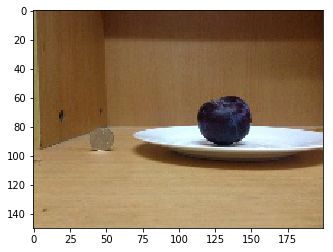

In [14]:
plt.imshow(plt.imread(featDF.loc[5024,'Path']))

In [15]:
featDF = featDF.drop(5024)

After removing broken record, there is no NaN value in dataset:

In [16]:
featDF.isna().sum(axis=1).sort_values(ascending=False)

10403    0
3454     0
3472     0
3471     0
3470     0
3469     0
3468     0
3467     0
3466     0
3465     0
3464     0
3463     0
3462     0
3461     0
3460     0
3459     0
3458     0
3457     0
3456     0
3473     0
3474     0
3475     0
3485     0
3492     0
3491     0
3490     0
3489     0
3488     0
3487     0
3486     0
        ..
6918     0
6928     0
6917     0
6916     0
6915     0
6914     0
6913     0
6912     0
6911     0
6927     0
6929     0
6947     0
6939     0
6946     0
6945     0
6944     0
6943     0
6942     0
6941     0
6940     0
6938     0
6930     0
6937     0
6936     0
6935     0
6934     0
6933     0
6932     0
6931     0
0        0
Length: 10403, dtype: int64

Checking balance of dataset:

In [17]:
featDF['ProdName'].value_counts()

APPLE          593
ORANGE         516
ONION          341
EGG            335
TOMATO         332
BREAD          287
PASTA          250
PEPPER         250
PEACH          250
CARROT         250
WATERMELON     250
BEAN           250
PEAR           250
OLIVE          250
GRAPE          250
MOONCAKE       250
DATES          250
BANANA         250
PAPAYA         250
LEMON          250
CHEESE         250
KIWI           250
FIRED          250
APRICOT        250
GRAPEFRUIT     250
QIWI           250
CUCUMBER       250
POMEGRANATE    250
SACHIMA        250
AUBERGINE      250
DOUGHNUT       250
SWEET          250
SAUCE          250
AVOCADO        250
MANGO          250
BUN            250
LITCHI         250
PLUM           249
Name: ProdName, dtype: int64

Cardinality of classes spans from 249 to 593. Dataset is not ideally balanced, but there are only few overrepresented classes. It can be assumed that no further data-balancing actions need to be taken.

In [21]:
featDF['ProdName'].unique().shape

(38,)

Input dataframe for classification contains 38 classes.

We can now split dataset. 20% of records will be used as validation set, 80% as training set.
We'll use following function:
```python
def split_dataset(feats_DF,label_column='ProdName',cols_to_drop=[], test_size = 0.2, random_state = 666):
    y = feats_DF[label_column]
    X = feats_DF.drop([label_column],axis=1)
    X = X.drop(cols_to_drop,axis=1)
    return train_test_split(X, y, test_size, random_state)
```

In [32]:
X_train, X_val, y_train, y_val = feex_module.split_dataset(featDF,label_column='ProdName',cols_to_drop=['Path'])

featDF can be now saved to pickle:

In [15]:
featDF.to_pickle(
    '''D:/PROGRAMMING_PROJS/FoodMachineLearning/FoodMLrepo/FoodML/dataframes/Features_dataframe_backup''')

In [33]:
X_train.head()

,RGB-CH1-0,RGB-CH1-1,RGB-CH1-2,RGB-CH1-3,RGB-CH1-4,RGB-CH1-5,RGB-CH1-6,RGB-CH1-7,RGB-CH1-8,RGB-CH1-9,...,RawPix_YDBDR3062,RawPix_YDBDR3063,RawPix_YDBDR3064,RawPix_YDBDR3065,RawPix_YDBDR3066,RawPix_YDBDR3067,RawPix_YDBDR3068,RawPix_YDBDR3069,RawPix_YDBDR3070,RawPix_YDBDR3071
2987,0.000013,0.000000,0.000046,0.000046,0.000039,0.000013,0.000007,0.000026,0.000373,0.001242,...,0.088769,0.078303,-0.094407,0.090057,0.082527,-0.099504,0.095959,0.080748,-0.097370,0.093747
3249,0.000055,0.000262,0.000379,0.000620,0.000888,0.001839,0.001708,0.002466,0.002486,0.002652,...,0.046864,0.051241,-0.061912,0.049257,0.049917,-0.060300,0.047854,0.052619,-0.063589,0.050609
4012,0.000168,0.000161,0.000132,0.000219,0.000263,0.000504,0.001053,0.002200,0.002500,0.002251,...,0.034667,0.043658,-0.052776,0.037301,0.043415,-0.052521,0.035652,0.043021,-0.052042,0.035768
10269,0.000069,0.000173,0.000873,0.002472,0.006119,0.009385,0.009186,0.008357,0.005807,0.006758,...,-0.048765,0.029871,-0.041506,-0.083798,0.041587,-0.058034,-0.122183,0.027352,-0.037932,-0.075095
6299,0.000024,0.000032,0.000016,0.000071,0.000047,0.000079,0.000174,0.000308,0.000537,0.001019,...,0.097246,0.086676,-0.104860,0.102900,0.099962,-0.120955,0.118210,0.080450,-0.097186,0.098689


Let's compare distributions of classes in training and validation set:

In [38]:
freqsDF = pd.DataFrame({'Train_freqs': y_train.value_counts(normalize=True),
                       'Val_freqs': y_val.value_counts(normalize=True)})

In [39]:
freqsDF

,Train_freqs,Val_freqs
APPLE,0.055996,0.061028
APRICOT,0.024273,0.023066
AUBERGINE,0.024033,0.024027
AVOCADO,0.025114,0.019702
BANANA,0.025595,0.017780
BEAN,0.023432,0.026430
BREAD,0.026436,0.032196
BUN,0.024634,0.021624
CARROT,0.023913,0.024507
CHEESE,0.023312,0.026910


It looks well, distributions are very similiar.
From now on, we won't be using validation set to analysis. We will use it only to validate the best models.

Storing session to file:

In [1]:
#import dill
#dill.dump_session('features_extracted_dataset_splitted.db')

In [24]:
import dill
dill.load_session('features_extracted_dataset_splitted.db')

## Classification <a name="classification"></a>

### Classification module <a name="classification_module"></a>
File "classification_module.py" contains ModelsBenchmark class, running transformators on data and searching optimal parameters.

ModelsBenchmark constructor:
This class contains five lists and five dictionaries:
* model_names - list of distinctive model names
* models - list containing models' definitions
* model_params - list of parameters' dictionaries
* transformator_names - list of transformators' distinctive names
* transformator_defs - list of transformators' definitions
* models_info_dict - dictionary with information on performance of tested models
* best_models_dict - dictionary with chosen best models
* best_models_results - dictionary with classification results for best models
* transformators - dictionary with fitted transformators
* transformators_components - dictionary of pca components for each transformator
```python
    def __init__(self, _names=[], _models=[], _params=[], _transformator_names=[],
                 _transformator_defs=[],
                 _models_info_dict={}, _best_models_dict={},
                 _best_models_results={},
                 _transformators={}, _transformators_components={}):
        self.model_names = _names
        self.models = _models
        self.model_params = _params
        self.transformator_names = _transformator_names
        self.transformator_defs = _transformator_defs
        self.models_info_dict = _models_info_dict
        self.best_models_dict = _best_models_dict
        self.best_models_results = _best_models_results
        self.transformators = _transformators
        self.transformators_components = _transformators_components
```

ModelsBenchmark, transformators fitting methods:
```python
    def fitLoadedTransformators(self, X, reset=False):
        self.fitTransformators(self, self.transformator_names,
                               self.transformator_defs, X, reset)

    def fitTransformators(self, names, transformators, X, reset=False):
        if reset:
            self.transformators = {}
            self.transformators_components = {}
        for name, transf in zip(names, transformators):
            transf_pipe = transf
            transf_pipe.fit(X)
            self.transformators[name] = transf_pipe
            self.transformators_components[name] = (
                transf_pipe.named_steps['pca'].components_,
                transf_pipe.named_steps['pca'].explained_variance_ratio_)
```

ModelsBenchmark, models' fitting and evaluating methods (for details refer to source file):
```python
def findBestParams(self, X_train, y_train, names,
                   models, params, transf_postfix, prio_score, folds=4, iters=20, randomized=True, scoring=None, n_jobs=-1, verbosity=0):
    
def evaluate_model(self, X, y_true, labels, model):
    
def runWithFixedParams(self, X_train, y_train, labels, names, models, print_shapes=False):
    
def runBenchmarkOnLoaded(self, X_train, y_train, prio_score, folds=4, iters=20, randomized=True,scoring=None, n_jobs=-1, verbosity=0, reset=False, print_shapes=False):
    
def runBenchmark(self, X_train, y_train, model_names, models,
                 model_params, transformators, prio_score, folds=4, iters=20, randomized=True, scoring=None, n_jobs=-1, verbosity=0, reset=False, print_shapes=False):
    
def fixedParamsBenchmark(self, X_train, y_train, labels, print_shapes=False):
```

### Dimensionality reduction <a name="dimensionality_reduction"></a>
X_train contains 16680 columns. It would be difficult to reasonably analyse this amount of variables. However, we can expect that many of those features will be strongly correlated to each other (due to methods of generating those features). Therefore, principial component analysis seems to be good first step in investigation importances of data. Also, in this case it is necessary to lower amount of features before attempting classification. This goal will also be achieved by using PCA. Before running PCA, we'll use VarianceThreshold transformation to drop features with low variance and therefore not very useful for classification.

First, let's see how many features have variance greater than 0.01:

In [25]:
selector = VarianceThreshold(0.01)
selector.fit(X_train)
Xs_train = selector.transform(X_train)
print(X_train.shape)
print(Xs_train.shape)
np.set_printoptions(threshold=np.inf)
print(np.array(X_train.columns[selector.variances_>0.01]))

(8322, 16680)
(8322, 3142)
['Cluster: 0 cspace: RGB; sortCH1; X' 'Cluster: 0 cspace: RGB; sortCH1; Y'
 'Cluster: 0 cspace: RGB; sortCH2; X' 'Cluster: 0 cspace: RGB; sortCH2; Y'
 'Cluster: 0 cspace: RGB; sortCH3; X' 'Cluster: 0 cspace: RGB; sortCH3; Y'
 'Cluster: 0 cspace: RGB; sortX; X' 'Cluster: 0 cspace: RGB; sortX; Y'
 'Cluster: 0 cspace: RGB; sortY; X' 'Cluster: 0 cspace: RGB; sortY; Y'
 'Cluster: 0 cspace: RGB; sortSize; X'
 'Cluster: 0 cspace: RGB; sortSize; Y'
 'Cluster: 1 cspace: RGB; sortCH1; X' 'Cluster: 1 cspace: RGB; sortCH1; Y'
 'Cluster: 1 cspace: RGB; sortCH2; X' 'Cluster: 1 cspace: RGB; sortCH2; Y'
 'Cluster: 1 cspace: RGB; sortCH3; X' 'Cluster: 1 cspace: RGB; sortCH3; Y'
 'Cluster: 1 cspace: RGB; sortX; X' 'Cluster: 1 cspace: RGB; sortX; Y'
 'Cluster: 1 cspace: RGB; sortY; X' 'Cluster: 1 cspace: RGB; sortY; Y'
 'Cluster: 1 cspace: RGB; sortSize; X'
 'Cluster: 1 cspace: RGB; sortSize; Y'
 'Cluster: 2 cspace: RGB; sortCH1; X' 'Cluster: 2 cspace: RGB; sortCH1; Y'
 'Cluste

 'Cluster: 4 cspace: YDBDR; sortSize; SIZE']


In [27]:
(3142/16680)*100

18.836930455635493

We're left with 3142 variables, which is about 18,8% of initial data. What happens if we set variance treshold to 0.1?

In [28]:
selector = VarianceThreshold(0.1)
selector.fit(X_train)
Xs_train = selector.transform(X_train)
print(X_train.shape)
print(Xs_train.shape)
np.set_printoptions(threshold=np.inf)
print(np.array(X_train.columns[selector.variances_>0.1]))

(8322, 16680)
(8322, 546)
['Cluster: 0 cspace: RGB; sortCH1; X' 'Cluster: 0 cspace: RGB; sortCH2; X'
 'Cluster: 0 cspace: RGB; sortCH3; X' 'Cluster: 0 cspace: RGB; sortX; X'
 'Cluster: 0 cspace: RGB; sortY; X' 'Cluster: 0 cspace: RGB; sortSize; X'
 'Cluster: 1 cspace: RGB; sortCH1; X' 'Cluster: 1 cspace: RGB; sortCH2; X'
 'Cluster: 1 cspace: RGB; sortCH3; X' 'Cluster: 1 cspace: RGB; sortX; X'
 'Cluster: 1 cspace: RGB; sortY; X' 'Cluster: 1 cspace: RGB; sortSize; X'
 'Cluster: 2 cspace: RGB; sortCH1; X' 'Cluster: 2 cspace: RGB; sortCH2; X'
 'Cluster: 2 cspace: RGB; sortCH3; X' 'Cluster: 3 cspace: RGB; sortCH3; X'
 'Cluster: 3 cspace: RGB; sortX; X' 'Cluster: 3 cspace: RGB; sortY; X'
 'Cluster: 3 cspace: RGB; sortSize; X'
 'Cluster: 4 cspace: RGB; sortCH1; X' 'Cluster: 4 cspace: RGB; sortCH2; X'
 'Cluster: 4 cspace: RGB; sortCH3; X' 'Cluster: 4 cspace: RGB; sortX; X'
 'Cluster: 4 cspace: RGB; sortY; X' 'Cluster: 4 cspace: RGB; sortSize; X'
 'HSV-CH1-0' 'HSV-CH1-1' 'HSV-CH1-2' 'HSV-CH1-3'

 'Cluster: 4 cspace: YDBDR; sortX; X' 'Cluster: 4 cspace: YDBDR; sortY; X']


In [29]:
(546/16680)*100

3.2733812949640293

We're left with 3.27% of original data. It can be also noticed that columns, which are left, are related to clusters received by using GMM clustering model and to extracted histograms of pixels' values. Features received from dividing images into blocks and raw pixels are gone. The more variables we can get rid of the better, because decrease of amount of data increases speed of classification algorithms. Also, removing unnecessary data can protect models from overfitting.

In [31]:
V_PCA = make_pipeline(VarianceThreshold(0.1), StandardScaler(),
                  PCA(n_components = 0.85, whiten = True, svd_solver = 'full'))
V_PCA.fit(X_train)
X_transf = V_PCA.transform(X_train)
X_transf.shape

(8322, 90)

Removing features with variance lesser than 0.1, running PCA and leaving components explaining more than 85% of variance results in array with 90 columns.
Let's check, how much of diversity is explained by each component:

In [33]:
np.sort(V_PCA.named_steps['pca'].explained_variance_ratio_)[::-1]

array([0.11372671, 0.10243344, 0.063285  , 0.03886541, 0.03783936,
       0.03131242, 0.02597047, 0.02338621, 0.02014085, 0.01800554,
       0.01690504, 0.01563043, 0.01510157, 0.01400175, 0.01231473,
       0.01103179, 0.01037011, 0.01028272, 0.00949018, 0.00874404,
       0.00814765, 0.0079783 , 0.0075878 , 0.00738401, 0.007139  ,
       0.00670655, 0.00630466, 0.00612694, 0.00603101, 0.00566034,
       0.00560946, 0.00537873, 0.00537195, 0.0051706 , 0.00501073,
       0.00483385, 0.00470226, 0.00450795, 0.00445071, 0.00430332,
       0.00419013, 0.00398612, 0.00396361, 0.00384795, 0.0037893 ,
       0.00367558, 0.0036477 , 0.00358701, 0.00349776, 0.00343888,
       0.00337992, 0.0033444 , 0.00328939, 0.00321999, 0.00315105,
       0.00310507, 0.00300926, 0.00297199, 0.00288115, 0.00283966,
       0.00281309, 0.00276504, 0.00269048, 0.00261538, 0.00255147,
       0.00246988, 0.00244909, 0.00240963, 0.00236685, 0.00233969,
       0.00228976, 0.00225401, 0.00222058, 0.00219164, 0.00213

Let's investigate impact of features on PCA components:

In [37]:
Filtered_cols = X_train.columns[V_PCA.named_steps['variancethreshold'].variances_>
               V_PCA.named_steps['variancethreshold'].threshold]
pca_compDF = pd.DataFrame(data=V_PCA.named_steps['pca'].components_,
                         columns = Filtered_cols)
pca_compDF.head()

,Cluster: 0 cspace: RGB; sortCH1; X,Cluster: 0 cspace: RGB; sortCH2; X,Cluster: 0 cspace: RGB; sortCH3; X,Cluster: 0 cspace: RGB; sortX; X,Cluster: 0 cspace: RGB; sortY; X,Cluster: 0 cspace: RGB; sortSize; X,Cluster: 1 cspace: RGB; sortCH1; X,Cluster: 1 cspace: RGB; sortCH2; X,Cluster: 1 cspace: RGB; sortCH3; X,Cluster: 1 cspace: RGB; sortX; X,...,Cluster: 2 cspace: YDBDR; sortCH3; X,Cluster: 3 cspace: YDBDR; sortCH3; X,Cluster: 3 cspace: YDBDR; sortX; X,Cluster: 3 cspace: YDBDR; sortY; X,Cluster: 3 cspace: YDBDR; sortSize; X,Cluster: 4 cspace: YDBDR; sortCH1; X,Cluster: 4 cspace: YDBDR; sortCH2; X,Cluster: 4 cspace: YDBDR; sortCH3; X,Cluster: 4 cspace: YDBDR; sortX; X,Cluster: 4 cspace: YDBDR; sortY; X
0,-0.012790,-0.011723,-0.019399,-0.023871,-0.026790,-0.018657,-0.011873,-0.017598,-0.023404,-0.022552,...,-0.014928,-0.014455,-0.019578,-0.023322,-0.020433,-0.010587,-0.007749,-0.011090,-0.015801,-0.025658
1,-0.036220,-0.015353,-0.008821,-0.015862,-0.014883,-0.034273,-0.012036,-0.007088,-0.016650,-0.021383,...,-0.031067,-0.035944,-0.014034,-0.024855,-0.032102,-0.021780,-0.039116,-0.033197,-0.029710,-0.011776
2,0.000490,-0.020577,-0.020382,-0.021096,-0.029501,0.000646,-0.012150,-0.022268,-0.026188,-0.030390,...,-0.012755,-0.018964,-0.014580,-0.025846,-0.024590,-0.007077,-0.020255,-0.019790,-0.016317,-0.014526
3,0.007928,0.029073,0.019028,0.020202,0.041496,-0.000028,0.025156,0.020713,0.030502,0.040883,...,0.010428,0.013487,0.027318,0.018699,0.015222,0.030757,0.010683,0.008489,0.013598,0.041925
4,0.030281,0.021287,0.015409,0.025416,0.046860,0.030911,0.021753,0.014439,0.023376,0.048392,...,0.027411,0.037108,0.015017,0.040844,0.037355,0.013303,0.026860,0.025218,0.020563,0.034264


In [38]:
pca_compDF_sort = pca_compDF.apply(lambda x: np.abs(x)).sort_values(by=0,axis=1,ascending=False)
pca_compDF_sort.head()

,HSV-CH2-33,CIE-CH3-37,CIE-CH3-34,CIE-CH2-36,CIE-CH2-38,CIE-CH3-35,CIE-CH2-37,CIE-CH2-39,CIE-CH3-39,CIE-CH3-36,...,HSV-CH1-19,CIE-CH1-19,HSV-CH3-11,CIE-CH2-22,HSV-CH1-5,CIE-CH1-48,YDBDR-CH2-30,CIE-CH1-39,HSV-CH1-21,HSV-CH1-17
0,0.093871,0.090960,0.090445,0.090431,0.088350,0.087408,0.087297,0.086487,0.085843,0.085786,...,0.001195,0.001043,0.001008,0.000978,0.000927,0.000593,0.000448,0.000412,0.000227,0.000070
1,0.008208,0.015362,0.034214,0.013771,0.022744,0.027557,0.000131,0.043080,0.057903,0.012523,...,0.024987,0.037562,0.006862,0.084040,0.046636,0.029090,0.070170,0.038101,0.014173,0.020552
2,0.013124,0.041422,0.039898,0.049219,0.046529,0.050811,0.052782,0.036444,0.017381,0.057105,...,0.063153,0.047646,0.081707,0.067727,0.035695,0.007306,0.063661,0.073050,0.059139,0.054966
3,0.006432,0.013156,0.033679,0.029813,0.007792,0.034697,0.022157,0.006493,0.018970,0.027756,...,0.066519,0.051936,0.053693,0.027316,0.043738,0.038723,0.006228,0.066921,0.063833,0.056841
4,0.008620,0.002457,0.013110,0.012199,0.006128,0.010255,0.009603,0.001146,0.008168,0.004920,...,0.059741,0.060235,0.091155,0.036818,0.013314,0.015335,0.043127,0.030636,0.067616,0.045334


In [43]:
pca_compDF_sort = pca_compDF.apply(lambda x: np.abs(x)).sort_values(by=1,axis=1,ascending=False)
pca_compDF_sort.head()

,CIE-CH2-28,CIE-CH3-27,CIE-CH2-27,CIE-CH3-25,CIE-CH3-24,HSV-CH2-28,CIE-CH2-29,HSV-CH2-27,CIE-CH2-44,CIE-CH3-26,...,YDBDR-CH1-32,YDBDR-CH1-12,HSV-CH3-36,HSV-CH2-13,HSV-CH3-28,HSV-CH3-35,HSV-CH3-13,CIE-CH2-13,CIE-CH2-37,CIE-CH3-13
0,0.052414,0.046627,0.042699,0.029750,0.020392,0.050405,0.060269,0.039970,0.061189,0.037580,...,0.081652,0.070400,0.007126,0.076492,0.009128,0.008183,0.004226,0.076490,0.087297,0.070804
1,0.090763,0.090054,0.089720,0.089252,0.089174,0.088915,0.088731,0.088666,0.088522,0.088496,...,0.001395,0.001333,0.001213,0.001032,0.000867,0.000810,0.000760,0.000375,0.000131,0.000104
2,0.018491,0.026159,0.030047,0.045737,0.054490,0.021114,0.004676,0.032920,0.045738,0.035349,...,0.012201,0.033657,0.039017,0.011213,0.048278,0.040767,0.077136,0.020422,0.052782,0.020824
3,0.011881,0.012328,0.005059,0.003683,0.010433,0.007697,0.022236,0.001039,0.050273,0.005654,...,0.004695,0.027148,0.031914,0.074070,0.042617,0.036771,0.050526,0.065712,0.022157,0.045674
4,0.012499,0.012014,0.009724,0.005739,0.018426,0.007011,0.014949,0.004472,0.012255,0.004716,...,0.002344,0.018094,0.127110,0.049184,0.141095,0.131953,0.109010,0.046200,0.009603,0.036183


In [44]:
pca_compDF_sort = pca_compDF.apply(lambda x: np.abs(x)).sort_values(by=2,axis=1,ascending=False)
pca_compDF_sort.head()

,YDBDR-CH2-44,YDBDR-CH1-4,CIE-CH1-34,YDBDR-CH1-5,CIE-CH1-35,YDBDR-CH1-6,YDBDR-CH2-43,HSV-CH3-10,YDBDR-CH2-45,HSV-CH1-36,...,HSV-CH3-48,HSV-CH1-9,CIE-CH3-11,YDBDR-CH3-21,CIE-CH1-8,YDBDR-CH2-25,CIE-CH1-12,YDBDR-CH3-47,Cluster: 0 cspace: RGB; sortSize; X,Cluster: 0 cspace: RGB; sortCH1; X
0,0.043532,0.034911,0.014574,0.045843,0.027042,0.046995,0.049455,0.003215,0.038201,0.004204,...,0.038944,0.001403,0.070443,0.006537,0.032806,0.053262,0.035723,0.042631,0.018657,0.012790
1,0.024109,0.022769,0.055615,0.025103,0.069227,0.022127,0.022901,0.012047,0.022374,0.041866,...,0.008891,0.009033,0.010051,0.040022,0.082556,0.072156,0.014929,0.063771,0.034273,0.036220
2,0.093390,0.090538,0.090270,0.088328,0.086051,0.085807,0.084503,0.083767,0.083518,0.083331,...,0.002177,0.002053,0.001466,0.001438,0.001111,0.001091,0.000902,0.000758,0.000646,0.000490
3,0.029653,0.037403,0.047929,0.031825,0.024544,0.018015,0.015897,0.055816,0.034849,0.066849,...,0.007646,0.034157,0.024737,0.052555,0.011103,0.051106,0.003328,0.041672,0.000028,0.007928
4,0.002672,0.016060,0.042107,0.003257,0.026954,0.016345,0.018585,0.079559,0.010149,0.026616,...,0.042322,0.008258,0.037096,0.036876,0.021612,0.004586,0.016645,0.019420,0.030911,0.030281


In [45]:
pca_compDF_sort = pca_compDF.apply(lambda x: np.abs(x)).sort_values(by=3,axis=1,ascending=False)
pca_compDF_sort.head()

,YDBDR-CH3-32,HSV-CH2-2,HSV-CH2-1,YDBDR-CH3-31,YDBDR-CH3-2,YDBDR-CH3-33,HSV-CH2-16,HSV-CH2-15,HSV-CH2-17,CIE-CH2-16,...,Cluster: 1 cspace: HSV; sortY; X,HSV-CH2-27,HSV-CH1-47,YDBDR-CH2-31,YDBDR-CH1-33,CIE-CH2-26,CIE-CH1-0,YDBDR-CH3-26,Cluster: 1 cspace: HSV; sortX; X,Cluster: 0 cspace: RGB; sortSize; X
0,0.038186,0.044572,0.033461,0.055138,0.019795,0.017106,0.053867,0.064915,0.041197,0.053298,...,0.011097,0.039970,0.018376,0.012233,0.075825,0.033020,0.015322,0.013395,0.016344,0.018657
1,0.038165,0.023433,0.018061,0.009437,0.028655,0.058377,0.044210,0.026260,0.058319,0.043779,...,0.041565,0.088666,0.015806,0.060588,0.002128,0.086762,0.047869,0.062299,0.031641,0.034273
2,0.037438,0.033139,0.040629,0.016968,0.058920,0.051283,0.050521,0.040898,0.059951,0.059522,...,0.004606,0.032920,0.043184,0.065808,0.018448,0.038547,0.028297,0.040210,0.014732,0.000646
3,0.102839,0.101423,0.100949,0.097289,0.093597,0.092897,0.091427,0.090268,0.088338,0.088096,...,0.001470,0.001039,0.000910,0.000780,0.000767,0.000664,0.000411,0.000366,0.000130,0.000028
4,0.004642,0.024444,0.050379,0.026838,0.052805,0.011184,0.003582,0.022722,0.011403,0.000961,...,0.027691,0.004472,0.026656,0.046105,0.000602,0.004317,0.033120,0.006512,0.022724,0.030911


In [46]:
pca_compDF_sort = pca_compDF.apply(lambda x: np.abs(x)).sort_values(by=4,axis=1,ascending=False)
pca_compDF_sort.head()

,HSV-CH3-28,HSV-CH3-27,HSV-CH3-26,HSV-CH3-29,HSV-CH3-25,HSV-CH3-32,HSV-CH3-34,HSV-CH3-30,HSV-CH3-31,HSV-CH3-33,...,HSV-CH3-2,YDBDR-CH1-33,YDBDR-CH2-18,YDBDR-CH3-7,YDBDR-CH2-17,CIE-CH3-6,HSV-CH2-40,HSV-CH1-1,YDBDR-CH3-1,HSV-CH1-4
0,0.009128,0.010288,0.011666,0.007491,0.011153,0.005149,0.007667,0.007734,0.004711,0.005792,...,0.033108,0.075825,0.078408,0.033880,0.068082,0.060840,0.081832,0.027657,0.025892,0.018995
1,0.000867,0.002536,0.006317,0.003212,0.010896,0.003810,0.002103,0.005554,0.003711,0.002980,...,0.061522,0.002128,0.005613,0.022137,0.013789,0.027758,0.068606,0.009249,0.013094,0.060797
2,0.048278,0.049208,0.049869,0.047409,0.050272,0.042544,0.041782,0.047381,0.044082,0.041417,...,0.066397,0.018448,0.014424,0.065456,0.022914,0.039674,0.007092,0.004714,0.025021,0.069782
3,0.042617,0.039327,0.037051,0.044163,0.035892,0.046500,0.041267,0.045399,0.047634,0.044106,...,0.016402,0.000767,0.011268,0.071498,0.010243,0.062030,0.026848,0.006566,0.081151,0.038951
4,0.141095,0.139341,0.139241,0.138778,0.135901,0.135616,0.135085,0.135080,0.135002,0.134489,...,0.000660,0.000602,0.000544,0.000537,0.000524,0.000390,0.000372,0.000196,0.000167,0.000069


In [40]:
pca_compDF_sort.describe().sort_values(by='max',axis=1,ascending=False)

,Cluster: 0 cspace: CIE; sortCH2; X,HSV-CH1-42,Cluster: 4 cspace: RGB; sortSize; X,HSV-CH1-29,HSV-CH1-34,Cluster: 4 cspace: RGB; sortCH1; X,HSV-CH1-38,Cluster: 3 cspace: RGB; sortSize; X,Cluster: 4 cspace: RGB; sortCH3; X,Cluster: 3 cspace: RGB; sortCH3; X,...,CIE-CH2-31,CIE-CH3-29,YDBDR-CH3-40,HSV-CH2-44,YDBDR-CH2-6,CIE-CH2-47,CIE-CH2-41,YDBDR-CH1-43,YDBDR-CH2-7,HSV-CH2-43
count,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,...,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000
mean,0.046809,0.045289,0.047652,0.037942,0.050470,0.038778,0.044569,0.045044,0.043758,0.042352,...,0.021164,0.022671,0.022028,0.017951,0.029908,0.025560,0.020837,0.026720,0.026495,0.019496
std,0.059663,0.055356,0.060949,0.044697,0.059639,0.052457,0.055793,0.054483,0.060495,0.047795,...,0.018136,0.016698,0.018922,0.017534,0.020235,0.018171,0.017319,0.018004,0.018787,0.016048
min,0.000037,0.000035,0.000132,0.000571,0.001021,0.000306,0.000083,0.000030,0.000075,0.000635,...,0.000283,0.000957,0.000614,0.000140,0.000607,0.000471,0.000520,0.000687,0.000397,0.000432
25%,0.011844,0.011483,0.011650,0.009966,0.013847,0.008704,0.012484,0.012879,0.005760,0.012711,...,0.009357,0.009607,0.007187,0.005575,0.013138,0.011173,0.008108,0.013970,0.009969,0.006664
50%,0.028329,0.029411,0.026126,0.027500,0.025675,0.019317,0.028180,0.024987,0.017218,0.028209,...,0.016843,0.018909,0.018260,0.012097,0.025961,0.022858,0.016888,0.022118,0.022532,0.015567
75%,0.060138,0.062134,0.059867,0.051507,0.067885,0.045289,0.053277,0.052376,0.059033,0.057504,...,0.026589,0.030682,0.028607,0.024610,0.046374,0.033190,0.029235,0.035912,0.038561,0.027207
max,0.437394,0.390365,0.367571,0.354624,0.344381,0.332792,0.331867,0.329684,0.327528,0.321840,...,0.079967,0.079943,0.079653,0.079435,0.077700,0.077627,0.077464,0.077043,0.076922,0.074260


In [42]:
pca_compDF_sort.describe().sort_values(by='min',axis=1,ascending=False)

,HSV-CH2-4,YDBDR-CH3-16,YDBDR-CH1-44,YDBDR-CH3-17,Cluster: 0 cspace: RGB; sortX; X,CIE-CH1-26,YDBDR-CH3-29,YDBDR-CH3-12,Cluster: 4 cspace: RGB; sortCH2; X,YDBDR-CH1-2,...,Cluster: 0 cspace: CIE; sortCH3; X,CIE-CH3-32,HSV-CH2-32,CIE-CH3-0,CIE-CH1-39,HSV-CH2-18,CIE-CH2-11,YDBDR-CH1-24,HSV-CH2-10,Cluster: 2 cspace: RGB; sortCH1; X
count,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,...,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,9.000000e+01,9.000000e+01,9.000000e+01
mean,0.034070,0.037910,0.029755,0.036926,0.039182,0.035680,0.029700,0.037789,0.047988,0.042381,...,0.049621,0.022883,0.019344,0.029876,0.029128,0.022404,0.022347,2.708230e-02,2.580516e-02,3.836611e-02
std,0.025449,0.024434,0.021142,0.024000,0.036826,0.024491,0.023684,0.022439,0.056123,0.025937,...,0.055129,0.016995,0.018513,0.024277,0.024915,0.022229,0.020760,2.193405e-02,2.217258e-02,4.032747e-02
min,0.002842,0.002722,0.002657,0.002417,0.002347,0.002014,0.002000,0.001872,0.001866,0.001837,...,0.000007,0.000006,0.000005,0.000005,0.000005,0.000004,0.000003,8.967368e-07,3.749892e-07,3.967277e-08
25%,0.015051,0.022878,0.011086,0.019042,0.015444,0.017085,0.011872,0.019020,0.011648,0.020829,...,0.014399,0.010395,0.006179,0.009241,0.010493,0.006498,0.006286,1.155600e-02,6.150046e-03,1.026783e-02
50%,0.025857,0.029356,0.026643,0.029877,0.025902,0.029708,0.023540,0.035179,0.024512,0.035980,...,0.027891,0.020442,0.014383,0.025642,0.019087,0.014871,0.018005,2.033848e-02,1.908508e-02,2.408462e-02
75%,0.049192,0.051947,0.042709,0.055044,0.053948,0.047446,0.041618,0.051880,0.056904,0.061248,...,0.067061,0.033207,0.024687,0.045872,0.045380,0.029731,0.031131,3.678672e-02,4.311169e-02,5.263122e-02
max,0.132614,0.107909,0.084486,0.102069,0.171694,0.099693,0.121787,0.095473,0.279571,0.106861,...,0.306282,0.091965,0.083345,0.135077,0.108113,0.085854,0.089332,1.117340e-01,8.412334e-02,1.740992e-01


In [41]:
pca_compDF_sort.describe().sort_values(by='mean',axis=1,ascending=False)

,HSV-CH1-34,Cluster: 4 cspace: RGB; sortY; X,Cluster: 0 cspace: CIE; sortCH3; X,Cluster: 4 cspace: RGB; sortCH2; X,Cluster: 1 cspace: HSV; sortSize; X,Cluster: 4 cspace: RGB; sortSize; X,Cluster: 2 cspace: HSV; sortCH2; X,Cluster: 1 cspace: YDBDR; sortCH3; X,Cluster: 3 cspace: RGB; sortX; X,Cluster: 1 cspace: YDBDR; sortCH1; X,...,HSV-CH2-47,CIE-CH3-48,CIE-CH3-43,CIE-CH3-41,HSV-CH2-44,CIE-CH2-42,HSV-CH2-46,CIE-CH2-44,HSV-CH2-45,CIE-CH2-43
count,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,...,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000,90.000000
mean,0.050470,0.050459,0.049621,0.047988,0.047801,0.047652,0.047155,0.047115,0.047045,0.047032,...,0.018872,0.018597,0.018151,0.018043,0.017951,0.017213,0.016553,0.015679,0.015663,0.013215
std,0.059639,0.064656,0.055129,0.056123,0.054688,0.060949,0.051855,0.043658,0.054862,0.042719,...,0.016043,0.023510,0.016268,0.014768,0.017534,0.016100,0.015366,0.015852,0.015995,0.016023
min,0.001021,0.000292,0.000007,0.001866,0.000020,0.000132,0.000210,0.000475,0.000204,0.000478,...,0.000319,0.000123,0.000604,0.000503,0.000140,0.000280,0.000254,0.000137,0.000115,0.000166
25%,0.013847,0.010979,0.014399,0.011648,0.013798,0.011650,0.017305,0.016636,0.011852,0.016536,...,0.007571,0.004805,0.006210,0.007501,0.005575,0.005511,0.006357,0.004713,0.004544,0.003349
50%,0.025675,0.025244,0.027891,0.024512,0.028968,0.026126,0.028910,0.032474,0.027663,0.036374,...,0.013158,0.012051,0.013591,0.015293,0.012097,0.012319,0.013278,0.011185,0.010954,0.007338
75%,0.067885,0.056933,0.067061,0.056904,0.051036,0.059867,0.052557,0.065005,0.057625,0.064028,...,0.026156,0.020250,0.026375,0.023580,0.024610,0.022979,0.020485,0.019475,0.021330,0.013943
max,0.344381,0.299254,0.306282,0.279571,0.251424,0.367571,0.259259,0.254253,0.319565,0.219542,...,0.084112,0.168558,0.086131,0.081621,0.079435,0.084730,0.083671,0.088522,0.087558,0.088133


Four most important components are influenced mostly by CIE and YDbDr histograms' values. Fifth component seems to be mostly influenced by HSV histograms. While analising statistical data, we can see that HSV histogram values (especially HSV-CH1-34, which can be interpreted as hue vaules slightly above mid-range) and clusters' data are strongly influencing some of the components.

Below is correlation matrix for 200 features which influence component 0 the most.The most important features have the strongest correlation.

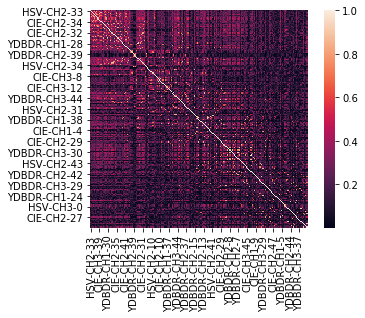

In [58]:
PCAcorr = pca_compDF.apply(lambda x: np.abs(x)).sort_values(by=0,axis=1,ascending=False).iloc[:,:200].corr()
f, ax = plt.subplots(1,1)
sns.heatmap((np.abs(PCAcorr)), vmax=1,square=True);

Let's compare correlation matrix of the least important component. Here correlations are much weaker.

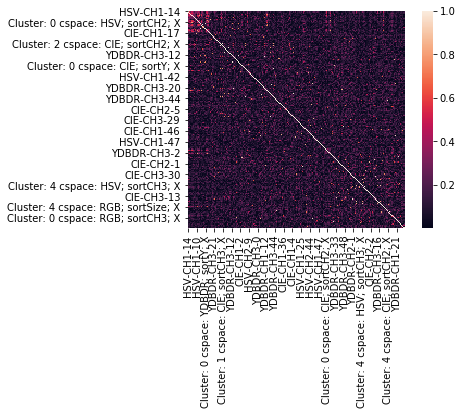

In [60]:
PCAcorr = pca_compDF.apply(lambda x: np.abs(x)).sort_values(by=89,axis=1,ascending=False).iloc[:,:200].corr()
f, ax = plt.subplots(1,1)
sns.heatmap((np.abs(PCAcorr)), vmax=1,square=True);

Correlation matrix for component 4 shows that this component is strongly influenced by HSV histograms:

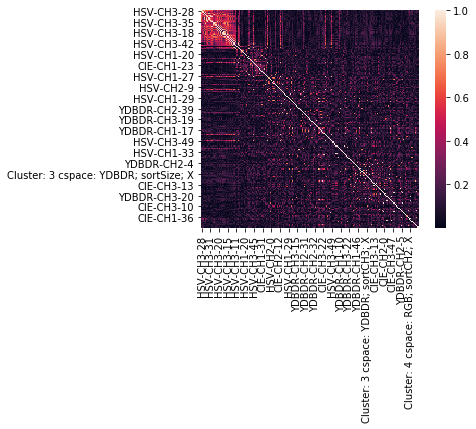

In [66]:
PCAcorr = pca_compDF.apply(lambda x: np.abs(x)).sort_values(by=4,axis=1,ascending=False).iloc[:,:200].corr()
f, ax = plt.subplots(1,1)
sns.heatmap((np.abs(PCAcorr)), vmax=1,square=True);

### Best model selection<a name="best_model_selection"></a>
Bunch of different models will be compared in order to find the best one and adjust parameters optimally.
Analyzed models:
* KNN
* Logistic Regression
* Decision Tree
* Random Forest
* SVC
* XGBoost
Randomized search has been run on set of models and parameters (parameters and logs from randomized search can be found in /foodml_src/learn_models.ipynb file).
Efficiency of each model will be compared.

Let's load models from disc:

In [72]:
benchmark_rand_batch1 = classmod.ModelsBenchmark()

In [73]:
rootDir = '''D:/PROGRAMMING_PROJS/FoodMachineLearning/FoodMLrepo/FoodML/foodml_src/'''
benchmark_rand_batch1.loadFromPickles(rootDir,'randomized_results_much_more')

In [78]:
best_results_filename = rootDir + "_best_results_" + '_randomized_results_much_more' + '.sav'
benchmark_rand_batch1.best_models_results = pickle.load(open(best_results_filename, 'rb'))

Constructing dataframe with training results:

In [81]:
results1_DF = pd.DataFrame.from_dict(benchmark_rand_batch1.best_models_results)
results1_DF.index = ['accuracy', 'f1', 'logloss', 'conf_matrix', 'class_report']
results1_DF.head()

,LogisticRegression_V001_PCA_70,RandomForestClassifier_V001_PCA_70,DecisionTreeClassifier_V001_PCA_70,KNeighborsClassifier_V001_PCA_70,MLPClassifier_V001_PCA_70,LogisticRegression_V001_PCA_5components,RandomForestClassifier_V001_PCA_5components,DecisionTreeClassifier_V001_PCA_5components,KNeighborsClassifier_V001_PCA_5components,MLPClassifier_V001_PCA_5components,...,KNeighborsClassifier_V09_PCA_90,MLPClassifier_V09_PCA_90,LogisticRegression_V09_PCA_80,RandomForestClassifier_V09_PCA_80,KNeighborsClassifier_V09_PCA_80,MLPClassifier_V09_PCA_80,LogisticRegression_V09_PCA_5components,RandomForestClassifier_V09_PCA_5components,KNeighborsClassifier_V09_PCA_5components,MLPClassifier_V09_PCA_5components
accuracy,0.777217,0.94821,0.145758,1,0.995434,0.274573,0.738645,0.184331,1,0.682648,...,1,0.996635,0.614996,0.89714,1,0.99976,0.254626,0.714732,1,0.655852
f1,0.774298,0.947869,0.0567226,1,0.995418,0.23962,0.735449,0.104587,1,0.679588,...,1,0.996657,0.596152,0.896077,1,0.99976,0.202832,0.709009,1,0.64727
logloss,0.860866,1.1338,2.79181,3.77252e-14,0.107211,2.46473,1.11258,2.59538,3.77252e-14,1.00778,...,3.77252e-14,0.0339851,1.39837,1.00269,3.77252e-14,0.0241236,2.682,1.17334,3.77252e-14,1.06891
conf_matrix,"[[285, 3, 0, 0, 9, 0, 2, 0, 2, 0, 1, 1, 9, 2, ...","[[451, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 1, 0, ...","[[0, 0, 128, 0, 0, 0, 0, 5, 0, 21, 23, 0, 0, 0...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[133, 8, 2, 4, 0, 0, 9, 8, 0, 2, 1, 0, 0, 10,...","[[314, 5, 1, 1, 11, 5, 0, 1, 1, 2, 1, 0, 2, 3,...","[[130, 18, 0, 54, 0, 10, 0, 5, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[260, 4, 2, 1, 15, 5, 5, 3, 4, 0, 1, 1, 7, 4,...",...,"[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[264, 5, 0, 2, 14, 3, 1, 0, 1, 0, 4, 2, 5, 4,...","[[438, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 2, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[163, 9, 1, 0, 6, 2, 24, 0, 2, 0, 0, 1, 0, 5,...","[[326, 4, 3, 0, 9, 2, 2, 0, 2, 4, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[224, 8, 3, 1, 10, 2, 1, 7, 4, 8, 3, 1, 8, 1,..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


Sorting dataframe by scores:

In [83]:
results1_DF.sort_values(by='logloss',axis=1,ascending=True)

,KNeighborsClassifier_V09_PCA_80,KNeighborsClassifier_V001_PCA_70,KNeighborsClassifier_V09_PCA_90,KNeighborsClassifier_V001_PCA_5components,KNeighborsClassifier_V01_PCA_5components,KNeighborsClassifier_V09_PCA_5components,KNeighborsClassifier_V01_PCA_80,KNeighborsClassifier_V01_PCA_85,MLPClassifier_V09_PCA_80,MLPClassifier_V01_PCA_85,...,RandomForestClassifier_V01_PCA_5components,LogisticRegression_V09_PCA_80,LogisticRegression_V001_PCA_5components,DecisionTreeClassifier_V001_PCA_5components,DecisionTreeClassifier_V09_PCA_90,LogisticRegression_V01_PCA_5components,LogisticRegression_V09_PCA_5components,DecisionTreeClassifier_V001_PCA_70,DecisionTreeClassifier_V01_PCA_5components,DecisionTreeClassifier_V01_PCA_85
accuracy,1,1,1,1,1,1,1,1,0.99976,1,...,0.717856,0.614996,0.274573,0.184331,0.231315,0.244533,0.254626,0.145758,0.144677,0.12497
f1,1,1,1,1,1,1,1,1,0.99976,1,...,0.712084,0.596152,0.23962,0.104587,0.159683,0.200333,0.202832,0.0567226,0.0665583,0.0347126
logloss,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,0.0241236,0.0246524,...,1.18666,1.39837,2.46473,2.59538,2.63122,2.6679,2.682,2.79181,2.80362,3.06661
conf_matrix,"[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",...,"[[342, 7, 3, 0, 5, 2, 3, 3, 4, 4, 0, 1, 3, 4, ...","[[264, 5, 0, 2, 14, 3, 1, 0, 1, 0, 4, 2, 5, 4,...","[[133, 8, 2, 4, 0, 0, 9, 8, 0, 2, 1, 0, 0, 10,...","[[130, 18, 0, 54, 0, 10, 0, 5, 0, 0, 0, 0, 0, ...","[[88, 15, 0, 14, 0, 0, 0, 3, 9, 0, 0, 0, 0, 0,...","[[157, 7, 1, 0, 1, 2, 18, 0, 2, 1, 1, 1, 1, 10...","[[163, 9, 1, 0, 6, 2, 24, 0, 2, 0, 0, 1, 0, 5,...","[[0, 0, 128, 0, 0, 0, 0, 5, 0, 21, 23, 0, 0, 0...","[[78, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 27, 0, 0, 0..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


In [110]:
results1_DF.sort_values(by='logloss',axis=1,ascending=True)

,KNeighborsClassifier_V09_PCA_80,KNeighborsClassifier_V001_PCA_70,KNeighborsClassifier_V09_PCA_90,KNeighborsClassifier_V001_PCA_5components,KNeighborsClassifier_V01_PCA_5components,KNeighborsClassifier_V09_PCA_5components,KNeighborsClassifier_V01_PCA_80,KNeighborsClassifier_V01_PCA_85,MLPClassifier_V09_PCA_80,MLPClassifier_V01_PCA_85,...,RandomForestClassifier_V01_PCA_5components,LogisticRegression_V09_PCA_80,LogisticRegression_V001_PCA_5components,DecisionTreeClassifier_V001_PCA_5components,DecisionTreeClassifier_V09_PCA_90,LogisticRegression_V01_PCA_5components,LogisticRegression_V09_PCA_5components,DecisionTreeClassifier_V001_PCA_70,DecisionTreeClassifier_V01_PCA_5components,DecisionTreeClassifier_V01_PCA_85
accuracy,1,1,1,1,1,1,1,1,0.99976,1,...,0.717856,0.614996,0.274573,0.184331,0.231315,0.244533,0.254626,0.145758,0.144677,0.12497
f1,1,1,1,1,1,1,1,1,0.99976,1,...,0.712084,0.596152,0.23962,0.104587,0.159683,0.200333,0.202832,0.0567226,0.0665583,0.0347126
logloss,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,3.77252e-14,0.0241236,0.0246524,...,1.18666,1.39837,2.46473,2.59538,2.63122,2.6679,2.682,2.79181,2.80362,3.06661
conf_matrix,"[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",...,"[[342, 7, 3, 0, 5, 2, 3, 3, 4, 4, 0, 1, 3, 4, ...","[[264, 5, 0, 2, 14, 3, 1, 0, 1, 0, 4, 2, 5, 4,...","[[133, 8, 2, 4, 0, 0, 9, 8, 0, 2, 1, 0, 0, 10,...","[[130, 18, 0, 54, 0, 10, 0, 5, 0, 0, 0, 0, 0, ...","[[88, 15, 0, 14, 0, 0, 0, 3, 9, 0, 0, 0, 0, 0,...","[[157, 7, 1, 0, 1, 2, 18, 0, 2, 1, 1, 1, 1, 10...","[[163, 9, 1, 0, 6, 2, 24, 0, 2, 0, 0, 1, 0, 5,...","[[0, 0, 128, 0, 0, 0, 0, 5, 0, 21, 23, 0, 0, 0...","[[78, 0, 10, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 27, 0, 0, 0..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


Preparing dataset with results of testing models on validation score:

In [ ]:
transf_arr = np.array([])
for col in results1_DF.columns:
    for trnsf in benchmark_rand_batch1.transformators.keys():
        if col.find(trnsf) > -1:
            transf_arr = np.append(transf_arr,trnsf)
transf_arr

results1_DF.loc[len(transf_arr)] = transf_arr

results1_DF.index = ['accuracy', 'f1', 'logloss', 'conf_matrix', 'class_report', 'transformator']
results1_DF

In [132]:
valid_resDF = pd.DataFrame(index=results1_DF.index[:5], columns=results1_DF.columns)
valid_resDF

,LogisticRegression_V001_PCA_70,RandomForestClassifier_V001_PCA_70,DecisionTreeClassifier_V001_PCA_70,KNeighborsClassifier_V001_PCA_70,MLPClassifier_V001_PCA_70,LogisticRegression_V001_PCA_5components,RandomForestClassifier_V001_PCA_5components,DecisionTreeClassifier_V001_PCA_5components,KNeighborsClassifier_V001_PCA_5components,MLPClassifier_V001_PCA_5components,...,KNeighborsClassifier_V09_PCA_90,MLPClassifier_V09_PCA_90,LogisticRegression_V09_PCA_80,RandomForestClassifier_V09_PCA_80,KNeighborsClassifier_V09_PCA_80,MLPClassifier_V09_PCA_80,LogisticRegression_V09_PCA_5components,RandomForestClassifier_V09_PCA_5components,KNeighborsClassifier_V09_PCA_5components,MLPClassifier_V09_PCA_5components
accuracy,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
f1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
logloss,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
conf_matrix,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
class_report,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [207]:
for estim in results1_DF.columns:
    X_val_tr = benchmark_rand_batch1.transformators[results1_DF[estim]['transformator']].transform(X_val)
    res = benchmark_rand_batch1.evaluate_model(X_val_tr,y_val,np.unique(y_val),
                                     benchmark_rand_batch1.best_models_dict[estim])
    valid_resDF[estim] = pd.Series(data=res).values
valid_resDF

C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'p

,LogisticRegression_V001_PCA_70,RandomForestClassifier_V001_PCA_70,DecisionTreeClassifier_V001_PCA_70,KNeighborsClassifier_V001_PCA_70,MLPClassifier_V001_PCA_70,LogisticRegression_V001_PCA_5components,RandomForestClassifier_V001_PCA_5components,DecisionTreeClassifier_V001_PCA_5components,KNeighborsClassifier_V001_PCA_5components,MLPClassifier_V001_PCA_5components,...,KNeighborsClassifier_V09_PCA_90,MLPClassifier_V09_PCA_90,LogisticRegression_V09_PCA_80,RandomForestClassifier_V09_PCA_80,KNeighborsClassifier_V09_PCA_80,MLPClassifier_V09_PCA_80,LogisticRegression_V09_PCA_5components,RandomForestClassifier_V09_PCA_5components,KNeighborsClassifier_V09_PCA_5components,MLPClassifier_V09_PCA_5components
accuracy,0.692936,0.748679,0.158097,0.746756,0.802018,0.281115,0.579529,0.172994,0.619414,0.583373,...,0.745315,0.824604,0.595867,0.728015,0.750601,0.833253,0.25853,0.560308,0.646324,0.578087
f1,0.688054,0.746236,0.0617163,0.745324,0.800925,0.24168,0.573869,0.0985295,0.617058,0.580745,...,0.742853,0.82481,0.573293,0.721873,0.747606,0.83324,0.211488,0.54955,0.640073,0.567623
logloss,1.063,1.56085,2.93164,2.58887,0.66149,2.45586,1.48539,2.82837,4.50204,1.33674,...,2.41531,0.74873,1.45754,1.34713,2.67947,0.677671,2.65896,1.53119,4.46718,1.33588
conf_matrix,"[[70, 0, 0, 0, 2, 0, 1, 0, 0, 0, 0, 2, 1, 1, 4...","[[96, 1, 0, 0, 2, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0...","[[0, 0, 32, 0, 0, 0, 0, 1, 0, 7, 7, 0, 0, 0, 0...","[[90, 1, 0, 0, 0, 2, 0, 0, 1, 0, 1, 0, 2, 0, 0...","[[97, 0, 1, 0, 2, 0, 1, 0, 0, 0, 0, 0, 1, 0, 2...","[[48, 2, 0, 2, 0, 0, 3, 0, 0, 0, 1, 0, 0, 6, 0...","[[61, 3, 0, 0, 5, 1, 1, 0, 2, 0, 2, 0, 2, 0, 0...","[[37, 5, 0, 18, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ...","[[70, 1, 0, 0, 6, 0, 2, 1, 0, 0, 0, 1, 2, 0, 0...","[[59, 1, 0, 0, 4, 0, 2, 3, 2, 0, 0, 0, 3, 1, 0...",...,"[[77, 1, 0, 0, 1, 2, 0, 1, 0, 0, 0, 0, 3, 0, 0...","[[104, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, ...","[[64, 2, 0, 0, 1, 2, 0, 1, 0, 0, 0, 1, 2, 1, 0...","[[85, 1, 0, 0, 2, 0, 0, 1, 0, 0, 0, 0, 1, 1, 0...","[[81, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 3, 0, 0...","[[93, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 1, 0...","[[48, 2, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 0, 7, 0...","[[58, 3, 1, 0, 8, 2, 2, 0, 1, 2, 0, 0, 0, 1, 0...","[[55, 2, 0, 0, 3, 1, 0, 1, 0, 1, 0, 1, 3, 2, 0...","[[38, 4, 0, 1, 1, 0, 0, 2, 1, 2, 1, 0, 3, 0, 2..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


Sorting dataframe with validation results by different scores:

In [152]:
valid_resDF.sort_values(by='logloss',axis=1,ascending=True)

,MLPClassifier_V001_PCA_70,MLPClassifier_V09_PCA_80,MLPClassifier_V01_PCA_80,MLPClassifier_V09_PCA_90,MLPClassifier_V01_PCA_85,LogisticRegression_V001_PCA_70,LogisticRegression_V09_PCA_90,LogisticRegression_V01_PCA_85,LogisticRegression_V01_PCA_80,MLPClassifier_V01_PCA_5components,...,DecisionTreeClassifier_V09_PCA_90,DecisionTreeClassifier_V001_PCA_5components,DecisionTreeClassifier_V01_PCA_5components,DecisionTreeClassifier_V001_PCA_70,DecisionTreeClassifier_V01_PCA_85,KNeighborsClassifier_V01_PCA_80,KNeighborsClassifier_V01_PCA_85,KNeighborsClassifier_V09_PCA_5components,KNeighborsClassifier_V001_PCA_5components,KNeighborsClassifier_V01_PCA_5components
accuracy,0.802018,0.833253,0.800577,0.824604,0.791927,0.692936,0.680442,0.671312,0.655454,0.613647,...,0.212398,0.172994,0.145123,0.158097,0.11629,0.685728,0.688131,0.646324,0.619414,0.638635
f1,0.800925,0.83324,0.799487,0.82481,0.791696,0.688054,0.667734,0.661026,0.646183,0.608325,...,0.147373,0.0985295,0.0663659,0.0617163,0.0309035,0.685107,0.687747,0.640073,0.617058,0.632779
logloss,0.66149,0.677671,0.702651,0.74873,0.817489,1.063,1.16092,1.2163,1.24222,1.29352,...,2.80766,2.82837,2.83795,2.93164,3.06334,3.26772,3.63507,4.46718,4.50204,4.5453
conf_matrix,"[[97, 0, 1, 0, 2, 0, 1, 0, 0, 0, 0, 0, 1, 0, 2...","[[93, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 1, 0...","[[99, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 4, 0, 0...","[[104, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, ...","[[90, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 4, 1, 1...","[[70, 0, 0, 0, 2, 0, 1, 0, 0, 0, 0, 2, 1, 1, 4...","[[79, 2, 1, 0, 0, 4, 1, 1, 0, 0, 0, 0, 1, 1, 2...","[[76, 1, 1, 0, 1, 2, 1, 0, 0, 0, 0, 0, 2, 0, 2...","[[73, 2, 1, 0, 1, 1, 1, 1, 0, 0, 0, 1, 1, 0, 1...","[[63, 3, 0, 0, 3, 0, 2, 2, 1, 1, 1, 0, 4, 3, 0...",...,"[[15, 4, 0, 2, 0, 0, 0, 5, 2, 0, 0, 0, 0, 0, 0...","[[37, 5, 0, 18, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ...","[[25, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1...","[[0, 0, 32, 0, 0, 0, 0, 1, 0, 7, 7, 0, 0, 0, 0...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 12, 0, 0, 0...","[[67, 2, 0, 1, 1, 1, 0, 0, 1, 0, 0, 0, 2, 0, 0...","[[70, 1, 0, 1, 1, 0, 0, 1, 0, 0, 0, 1, 3, 0, 0...","[[55, 2, 0, 0, 3, 1, 0, 1, 0, 1, 0, 1, 3, 2, 0...","[[70, 1, 0, 0, 6, 0, 2, 1, 0, 0, 0, 1, 2, 0, 0...","[[66, 1, 0, 0, 2, 1, 2, 0, 1, 2, 0, 0, 1, 2, 0..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


In [156]:
valid_resDF.sort_values(by='f1',axis=1,ascending=False)

,MLPClassifier_V09_PCA_80,MLPClassifier_V09_PCA_90,MLPClassifier_V001_PCA_70,MLPClassifier_V01_PCA_80,MLPClassifier_V01_PCA_85,KNeighborsClassifier_V09_PCA_80,RandomForestClassifier_V001_PCA_70,KNeighborsClassifier_V001_PCA_70,KNeighborsClassifier_V09_PCA_90,RandomForestClassifier_V09_PCA_90,...,RandomForestClassifier_V01_PCA_5components,RandomForestClassifier_V09_PCA_5components,LogisticRegression_V001_PCA_5components,LogisticRegression_V01_PCA_5components,LogisticRegression_V09_PCA_5components,DecisionTreeClassifier_V09_PCA_90,DecisionTreeClassifier_V001_PCA_5components,DecisionTreeClassifier_V01_PCA_5components,DecisionTreeClassifier_V001_PCA_70,DecisionTreeClassifier_V01_PCA_85
accuracy,0.833253,0.824604,0.802018,0.800577,0.791927,0.750601,0.748679,0.746756,0.745315,0.740029,...,0.56223,0.560308,0.281115,0.254685,0.25853,0.212398,0.172994,0.145123,0.158097,0.11629
f1,0.83324,0.82481,0.800925,0.799487,0.791696,0.747606,0.746236,0.745324,0.742853,0.733205,...,0.552531,0.54955,0.24168,0.213027,0.211488,0.147373,0.0985295,0.0663659,0.0617163,0.0309035
logloss,0.677671,0.74873,0.66149,0.702651,0.817489,2.67947,1.56085,2.58887,2.41531,1.4425,...,1.55094,1.53119,2.45586,2.64841,2.65896,2.80766,2.82837,2.83795,2.93164,3.06334
conf_matrix,"[[93, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 1, 0...","[[104, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, ...","[[97, 0, 1, 0, 2, 0, 1, 0, 0, 0, 0, 0, 1, 0, 2...","[[99, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 4, 0, 0...","[[90, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 4, 1, 1...","[[81, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 3, 0, 0...","[[96, 1, 0, 0, 2, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0...","[[90, 1, 0, 0, 0, 2, 0, 0, 1, 0, 1, 0, 2, 0, 0...","[[77, 1, 0, 0, 1, 2, 0, 1, 0, 0, 0, 0, 3, 0, 0...","[[90, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 2, 0, 0...",...,"[[51, 4, 0, 0, 6, 1, 3, 0, 2, 1, 0, 0, 2, 3, 0...","[[58, 3, 1, 0, 8, 2, 2, 0, 1, 2, 0, 0, 0, 1, 0...","[[48, 2, 0, 2, 0, 0, 3, 0, 0, 0, 1, 0, 0, 6, 0...","[[43, 3, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 9, 0...","[[48, 2, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 0, 7, 0...","[[15, 4, 0, 2, 0, 0, 0, 5, 2, 0, 0, 0, 0, 0, 0...","[[37, 5, 0, 18, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ...","[[25, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1...","[[0, 0, 32, 0, 0, 0, 0, 1, 0, 7, 7, 0, 0, 0, 0...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 12, 0, 0, 0..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


In [157]:
valid_resDF.sort_values(by='accuracy',axis=1,ascending=False)

,MLPClassifier_V09_PCA_80,MLPClassifier_V09_PCA_90,MLPClassifier_V001_PCA_70,MLPClassifier_V01_PCA_80,MLPClassifier_V01_PCA_85,KNeighborsClassifier_V09_PCA_80,RandomForestClassifier_V001_PCA_70,KNeighborsClassifier_V001_PCA_70,KNeighborsClassifier_V09_PCA_90,RandomForestClassifier_V09_PCA_90,...,RandomForestClassifier_V01_PCA_5components,RandomForestClassifier_V09_PCA_5components,LogisticRegression_V001_PCA_5components,LogisticRegression_V09_PCA_5components,LogisticRegression_V01_PCA_5components,DecisionTreeClassifier_V09_PCA_90,DecisionTreeClassifier_V001_PCA_5components,DecisionTreeClassifier_V001_PCA_70,DecisionTreeClassifier_V01_PCA_5components,DecisionTreeClassifier_V01_PCA_85
accuracy,0.833253,0.824604,0.802018,0.800577,0.791927,0.750601,0.748679,0.746756,0.745315,0.740029,...,0.56223,0.560308,0.281115,0.25853,0.254685,0.212398,0.172994,0.158097,0.145123,0.11629
f1,0.83324,0.82481,0.800925,0.799487,0.791696,0.747606,0.746236,0.745324,0.742853,0.733205,...,0.552531,0.54955,0.24168,0.211488,0.213027,0.147373,0.0985295,0.0617163,0.0663659,0.0309035
logloss,0.677671,0.74873,0.66149,0.702651,0.817489,2.67947,1.56085,2.58887,2.41531,1.4425,...,1.55094,1.53119,2.45586,2.65896,2.64841,2.80766,2.82837,2.93164,2.83795,3.06334
conf_matrix,"[[93, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 1, 0...","[[104, 1, 0, 0, 0, 0, 1, 1, 0, 0, 0, 0, 0, 1, ...","[[97, 0, 1, 0, 2, 0, 1, 0, 0, 0, 0, 0, 1, 0, 2...","[[99, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 0, 4, 0, 0...","[[90, 0, 1, 1, 0, 0, 0, 1, 0, 0, 0, 0, 4, 1, 1...","[[81, 0, 0, 0, 1, 0, 1, 1, 0, 0, 0, 1, 3, 0, 0...","[[96, 1, 0, 0, 2, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0...","[[90, 1, 0, 0, 0, 2, 0, 0, 1, 0, 1, 0, 2, 0, 0...","[[77, 1, 0, 0, 1, 2, 0, 1, 0, 0, 0, 0, 3, 0, 0...","[[90, 1, 1, 0, 0, 1, 0, 1, 0, 0, 0, 0, 2, 0, 0...",...,"[[51, 4, 0, 0, 6, 1, 3, 0, 2, 1, 0, 0, 2, 3, 0...","[[58, 3, 1, 0, 8, 2, 2, 0, 1, 2, 0, 0, 0, 1, 0...","[[48, 2, 0, 2, 0, 0, 3, 0, 0, 0, 1, 0, 0, 6, 0...","[[48, 2, 0, 0, 2, 0, 1, 0, 0, 0, 0, 0, 0, 7, 0...","[[43, 3, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 1, 9, 0...","[[15, 4, 0, 2, 0, 0, 0, 5, 2, 0, 0, 0, 0, 0, 0...","[[37, 5, 0, 18, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, ...","[[0, 0, 32, 0, 0, 0, 0, 1, 0, 7, 7, 0, 0, 0, 0...","[[25, 0, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1...","[[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 12, 0, 0, 0..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


We can see, that 'MLPClassifier_V09_PCA_80' model has the best performance on validation set. Another MLP model, 'MLPClassifier_V001_PCA_70' minimizes log loss slightly better.
MLP Classifiers seem to handle this dataset better than other ones.
Let's compare scores on training and validation sets:

In [223]:
valid_resDF['MLPClassifier_V09_PCA_80']

accuracy                                                 0.833253
f1                                                        0.83324
logloss                                                  0.677671
conf_matrix     [[93, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 1, 0...
class_report                 precision    recall  f1-score   s...
Name: MLPClassifier_V09_PCA_80, dtype: object

In [224]:
results1_DF['MLPClassifier_V09_PCA_80']

accuracy                                                   0.99976
f1                                                         0.99976
logloss                                                  0.0241236
conf_matrix      [[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...
class_report                  precision    recall  f1-score   s...
transformator                                           V09_PCA_80
Name: MLPClassifier_V09_PCA_80, dtype: object

In [225]:
valid_resDF['MLPClassifier_V001_PCA_70']

accuracy                                                 0.802018
f1                                                       0.800925
logloss                                                   0.66149
conf_matrix     [[97, 0, 1, 0, 2, 0, 1, 0, 0, 0, 0, 0, 1, 0, 2...
class_report                 precision    recall  f1-score   s...
Name: MLPClassifier_V001_PCA_70, dtype: object

In [226]:
results1_DF['MLPClassifier_V001_PCA_70']

accuracy                                                  0.995434
f1                                                        0.995418
logloss                                                   0.107211
conf_matrix      [[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...
class_report                  precision    recall  f1-score   s...
transformator                                          V001_PCA_70
Name: MLPClassifier_V001_PCA_70, dtype: object

Both classifiers are a bit overtrained. However, they still handle validtion data well.

Drawing confusion matrices for selected models:

In [201]:
confData_MLPClassifier_V09_PCA_80 = pd.DataFrame(data = valid_resDF['MLPClassifier_V09_PCA_80']['conf_matrix'], index = np.unique(y_val),
                        columns = np.unique(y_val))
confData_MLPClassifier_V09_PCA_80

,APPLE,APRICOT,AUBERGINE,AVOCADO,BANANA,BEAN,BREAD,BUN,CARROT,CHEESE,...,PEAR,PEPPER,PLUM,POMEGRANATE,QIWI,SACHIMA,SAUCE,SWEET,TOMATO,WATERMELON
APPLE,93,1,0,0,0,0,0,0,0,0,...,4,1,1,1,1,3,0,0,7,0
APRICOT,0,45,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AUBERGINE,0,0,50,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
AVOCADO,0,0,0,41,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BANANA,0,0,0,0,23,0,1,0,0,0,...,0,0,0,0,1,1,0,0,0,0
BEAN,0,0,0,0,0,54,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
BREAD,1,0,0,0,2,2,56,0,0,2,...,0,0,0,0,1,0,0,0,0,0
BUN,1,0,0,0,0,0,0,37,0,0,...,0,0,0,0,0,4,0,0,0,0
CARROT,0,0,0,0,0,0,0,0,46,0,...,0,1,0,0,1,0,0,0,0,2
CHEESE,0,0,0,0,0,0,0,0,0,54,...,0,0,0,0,0,0,0,0,0,0


Helper function to draw more visible matrices:

In [211]:
def makeDFpretty(df,color):
    styles = [dict(selector="th", props=[("font-size", "65%"),
                               ("text-align", "center"),
                              ("transform", "translate(10%,10%) rotate(-50deg)")
                              ]),dict(selector=".row_heading, .blank", props= [("font-size", "60%"),
                                ("transform", "translate(0%,0%) rotate(0deg)")])]
    cm = sns.light_palette(color, as_cmap=True)
    html = df.style.set_table_styles(styles).background_gradient(cmap=cm).set_properties(
        **{'color': 'black'}).render()
    display(HTML(html))

In [212]:
makeDFpretty(confData_MLPClassifier_V09_PCA_80,'green')

In [205]:
confData_MLPClassifier_V001_PCA_70 = pd.DataFrame(data = valid_resDF['MLPClassifier_V001_PCA_70']['conf_matrix'], index = np.unique(y_val),
                        columns = np.unique(y_val))

In [213]:
makeDFpretty(confData_MLPClassifier_V001_PCA_70,'green')

Testing models basing on SVC and XGBoost:

In [227]:
benchmark_rand_xgb = classmod.ModelsBenchmark()
benchmark_rand_xgb.loadFromPickles(rootDir,'randomized_results_svc_xgboost')

In [214]:
resultsxgb_DF = pd.DataFrame.from_dict(benchmark_rand_xgb.best_models_results)
resultsxgb_DF.index = ['accuracy', 'f1', 'logloss', 'conf_matrix', 'class_report']
resultsxgb_DF.head()

,SVC_V001_PCA_70,SVC_V001_PCA_5components,SVC_V01_PCA_85,XGBClassifier_tree_V001_PCA_70,XGBClassifier_tree_V001_PCA_5components,XGBClassifier_tree_V01_PCA_85,SVC_V01_PCA_80,XGBClassifier_tree_V01_PCA_80,SVC_V01_PCA_5components,XGBClassifier_tree_V01_PCA_5components,SVC_V09_PCA_90,XGBClassifier_tree_V09_PCA_90,SVC_V09_PCA_80,XGBClassifier_tree_V09_PCA_80,SVC_V09_PCA_5components,XGBClassifier_tree_V09_PCA_5components
accuracy,0.985821,0.483417,0.43379,0.879116,0.696708,0.99976,0.812305,0.913723,0.397621,0.997477,0.69863,0.998919,0.768565,1,0.381879,0.804254
f1,0.985876,0.47846,0.41935,0.878998,0.693394,0.99976,0.811693,0.913576,0.366661,0.997478,0.695246,0.998917,0.766678,1,0.343431,0.803308
logloss,0.181438,1.56512,1.44555,0.638767,1.18215,0.0386065,0.551577,0.649717,1.90814,0.179705,0.845782,0.0564289,0.916429,0.0226858,1.8986,0.767648
conf_matrix,"[[458, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[196, 10, 1, 2, 6, 9, 4, 0, 4, 1, 2, 0, 1, 0,...","[[433, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 8, ...","[[406, 0, 0, 0, 7, 1, 1, 0, 0, 2, 0, 0, 1, 0, ...","[[267, 5, 1, 1, 12, 10, 2, 2, 0, 1, 3, 0, 2, 2...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[392, 0, 0, 1, 4, 1, 0, 0, 0, 0, 0, 0, 3, 2, ...","[[433, 0, 0, 0, 1, 1, 0, 0, 2, 0, 1, 1, 2, 3, ...","[[236, 18, 3, 0, 0, 8, 8, 0, 2, 2, 1, 1, 0, 4,...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[375, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 1, 17,...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[350, 2, 0, 1, 8, 1, 0, 2, 0, 0, 0, 0, 7, 1, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[265, 5, 3, 0, 0, 5, 8, 0, 4, 6, 0, 0, 0, 1, ...","[[376, 3, 0, 0, 5, 3, 2, 4, 0, 3, 1, 0, 3, 1, ..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


In [215]:
transf_arr = np.array([])
for col in resultsxgb_DF.columns:
    for trnsf in benchmark_rand_xgb.transformators.keys():
        if col.find(trnsf) > -1:
            transf_arr = np.append(transf_arr,trnsf)
transf_arr

resultsxgb_DF.loc[len(transf_arr)] = transf_arr

resultsxgb_DF.index = ['accuracy', 'f1', 'logloss', 'conf_matrix', 'class_report', 'transformator']
resultsxgb_DF

,SVC_V001_PCA_70,SVC_V001_PCA_5components,SVC_V01_PCA_85,XGBClassifier_tree_V001_PCA_70,XGBClassifier_tree_V001_PCA_5components,XGBClassifier_tree_V01_PCA_85,SVC_V01_PCA_80,XGBClassifier_tree_V01_PCA_80,SVC_V01_PCA_5components,XGBClassifier_tree_V01_PCA_5components,SVC_V09_PCA_90,XGBClassifier_tree_V09_PCA_90,SVC_V09_PCA_80,XGBClassifier_tree_V09_PCA_80,SVC_V09_PCA_5components,XGBClassifier_tree_V09_PCA_5components
accuracy,0.985821,0.483417,0.43379,0.879116,0.696708,0.99976,0.812305,0.913723,0.397621,0.997477,0.69863,0.998919,0.768565,1,0.381879,0.804254
f1,0.985876,0.47846,0.41935,0.878998,0.693394,0.99976,0.811693,0.913576,0.366661,0.997478,0.695246,0.998917,0.766678,1,0.343431,0.803308
logloss,0.181438,1.56512,1.44555,0.638767,1.18215,0.0386065,0.551577,0.649717,1.90814,0.179705,0.845782,0.0564289,0.916429,0.0226858,1.8986,0.767648
conf_matrix,"[[458, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[196, 10, 1, 2, 6, 9, 4, 0, 4, 1, 2, 0, 1, 0,...","[[433, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 8, ...","[[406, 0, 0, 0, 7, 1, 1, 0, 0, 2, 0, 0, 1, 0, ...","[[267, 5, 1, 1, 12, 10, 2, 2, 0, 1, 3, 0, 2, 2...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[392, 0, 0, 1, 4, 1, 0, 0, 0, 0, 0, 0, 3, 2, ...","[[433, 0, 0, 0, 1, 1, 0, 0, 2, 0, 1, 1, 2, 3, ...","[[236, 18, 3, 0, 0, 8, 8, 0, 2, 2, 1, 1, 0, 4,...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[375, 0, 0, 0, 2, 0, 0, 0, 0, 0, 0, 0, 1, 17,...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[350, 2, 0, 1, 8, 1, 0, 2, 0, 0, 0, 0, 7, 1, ...","[[466, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...","[[265, 5, 3, 0, 0, 5, 8, 0, 4, 6, 0, 0, 0, 1, ...","[[376, 3, 0, 0, 5, 3, 2, 4, 0, 3, 1, 0, 3, 1, ..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...
transformator,V001_PCA_70,V001_PCA_5components,V01_PCA_85,V001_PCA_70,V001_PCA_5components,V01_PCA_85,V01_PCA_80,V01_PCA_80,V01_PCA_5components,V01_PCA_5components,V09_PCA_90,V09_PCA_90,V09_PCA_80,V09_PCA_80,V09_PCA_5components,V09_PCA_5components


In [217]:
valid_resDFxgb = pd.DataFrame(index=resultsxgb_DF.index[:5], columns=resultsxgb_DF.columns)
for estim in resultsxgb_DF.columns:
    X_val_tr = benchmark_rand_xgb.transformators[resultsxgb_DF[estim]['transformator']].transform(X_val)
    res = benchmark_rand_xgb.evaluate_model(X_val_tr,y_val,np.unique(y_val),
                                     benchmark_rand_xgb.best_models_dict[estim])
    valid_resDFxgb[estim] = pd.Series(data=res).values
valid_resDFxgb

C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: F-score is ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\sklearn\metrics\classification.py:1135: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples.
  'precision', 'predicted', average, warn_for)
C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future this will result in an error. Use `array.size > 0` to check that an array is not empty.
  if diff:
C:\Users\AdamT\Anaconda3\envs\foodmlenv\lib\site-packages\sklearn\preprocessing\label.py:151: DeprecationWarning: The truth value of an empty array is ambiguous. Returning False, but in future 

,SVC_V001_PCA_70,SVC_V001_PCA_5components,SVC_V01_PCA_85,XGBClassifier_tree_V001_PCA_70,XGBClassifier_tree_V001_PCA_5components,XGBClassifier_tree_V01_PCA_85,SVC_V01_PCA_80,XGBClassifier_tree_V01_PCA_80,SVC_V01_PCA_5components,XGBClassifier_tree_V01_PCA_5components,SVC_V09_PCA_90,XGBClassifier_tree_V09_PCA_90,SVC_V09_PCA_80,XGBClassifier_tree_V09_PCA_80,SVC_V09_PCA_5components,XGBClassifier_tree_V09_PCA_5components
accuracy,0.815954,0.466603,0.402691,0.632869,0.530995,0.713599,0.71408,0.697741,0.388755,0.559827,0.658337,0.754926,0.711677,0.78568,0.372417,0.506487
f1,0.816805,0.462641,0.377152,0.631651,0.526834,0.715195,0.711695,0.696565,0.360969,0.554852,0.652915,0.754223,0.709053,0.785488,0.337166,0.50328
logloss,0.723916,1.63697,1.62233,1.25487,1.59081,0.998427,0.893779,1.20866,1.92389,1.63556,1.04689,0.883725,1.05111,0.692916,1.92752,1.67421
conf_matrix,"[[104, 0, 1, 2, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, ...","[[51, 3, 0, 0, 4, 1, 1, 2, 0, 1, 1, 0, 0, 0, 0...","[[121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, ...","[[76, 1, 0, 0, 5, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1...","[[50, 3, 0, 0, 6, 3, 2, 1, 1, 0, 1, 0, 0, 0, 0...","[[79, 1, 1, 0, 2, 0, 0, 1, 1, 0, 0, 0, 5, 1, 1...","[[93, 1, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 1, 3, 0...","[[86, 0, 1, 0, 2, 0, 1, 1, 0, 0, 0, 0, 4, 0, 1...","[[63, 4, 0, 0, 0, 3, 4, 0, 0, 0, 0, 0, 0, 4, 0...","[[49, 3, 1, 0, 6, 2, 3, 1, 0, 1, 0, 0, 1, 3, 0...","[[101, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 3, ...","[[86, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0...","[[87, 2, 1, 0, 1, 0, 1, 3, 0, 0, 0, 0, 3, 1, 0...","[[85, 2, 0, 0, 4, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1...","[[64, 4, 0, 0, 0, 3, 3, 0, 1, 2, 0, 0, 0, 3, 0...","[[47, 0, 0, 0, 6, 2, 1, 1, 0, 2, 0, 0, 3, 3, 1..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


Sorting dataframe with validation results:

In [218]:
valid_resDFxgb.sort_values(by='logloss',axis=1,ascending=True)

,XGBClassifier_tree_V09_PCA_80,SVC_V001_PCA_70,XGBClassifier_tree_V09_PCA_90,SVC_V01_PCA_80,XGBClassifier_tree_V01_PCA_85,SVC_V09_PCA_90,SVC_V09_PCA_80,XGBClassifier_tree_V01_PCA_80,XGBClassifier_tree_V001_PCA_70,XGBClassifier_tree_V001_PCA_5components,SVC_V01_PCA_85,XGBClassifier_tree_V01_PCA_5components,SVC_V001_PCA_5components,XGBClassifier_tree_V09_PCA_5components,SVC_V01_PCA_5components,SVC_V09_PCA_5components
accuracy,0.78568,0.815954,0.754926,0.71408,0.713599,0.658337,0.711677,0.697741,0.632869,0.530995,0.402691,0.559827,0.466603,0.506487,0.388755,0.372417
f1,0.785488,0.816805,0.754223,0.711695,0.715195,0.652915,0.709053,0.696565,0.631651,0.526834,0.377152,0.554852,0.462641,0.50328,0.360969,0.337166
logloss,0.692916,0.723916,0.883725,0.893779,0.998427,1.04689,1.05111,1.20866,1.25487,1.59081,1.62233,1.63556,1.63697,1.67421,1.92389,1.92752
conf_matrix,"[[85, 2, 0, 0, 4, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1...","[[104, 0, 1, 2, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, ...","[[86, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0...","[[93, 1, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 1, 3, 0...","[[79, 1, 1, 0, 2, 0, 0, 1, 1, 0, 0, 0, 5, 1, 1...","[[101, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 3, ...","[[87, 2, 1, 0, 1, 0, 1, 3, 0, 0, 0, 0, 3, 1, 0...","[[86, 0, 1, 0, 2, 0, 1, 1, 0, 0, 0, 0, 4, 0, 1...","[[76, 1, 0, 0, 5, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1...","[[50, 3, 0, 0, 6, 3, 2, 1, 1, 0, 1, 0, 0, 0, 0...","[[121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, ...","[[49, 3, 1, 0, 6, 2, 3, 1, 0, 1, 0, 0, 1, 3, 0...","[[51, 3, 0, 0, 4, 1, 1, 2, 0, 1, 1, 0, 0, 0, 0...","[[47, 0, 0, 0, 6, 2, 1, 1, 0, 2, 0, 0, 3, 3, 1...","[[63, 4, 0, 0, 0, 3, 4, 0, 0, 0, 0, 0, 0, 4, 0...","[[64, 4, 0, 0, 0, 3, 3, 0, 1, 2, 0, 0, 0, 3, 0..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


In [219]:
valid_resDFxgb.sort_values(by='accuracy',axis=1,ascending=False)

,SVC_V001_PCA_70,XGBClassifier_tree_V09_PCA_80,XGBClassifier_tree_V09_PCA_90,SVC_V01_PCA_80,XGBClassifier_tree_V01_PCA_85,SVC_V09_PCA_80,XGBClassifier_tree_V01_PCA_80,SVC_V09_PCA_90,XGBClassifier_tree_V001_PCA_70,XGBClassifier_tree_V01_PCA_5components,XGBClassifier_tree_V001_PCA_5components,XGBClassifier_tree_V09_PCA_5components,SVC_V001_PCA_5components,SVC_V01_PCA_85,SVC_V01_PCA_5components,SVC_V09_PCA_5components
accuracy,0.815954,0.78568,0.754926,0.71408,0.713599,0.711677,0.697741,0.658337,0.632869,0.559827,0.530995,0.506487,0.466603,0.402691,0.388755,0.372417
f1,0.816805,0.785488,0.754223,0.711695,0.715195,0.709053,0.696565,0.652915,0.631651,0.554852,0.526834,0.50328,0.462641,0.377152,0.360969,0.337166
logloss,0.723916,0.692916,0.883725,0.893779,0.998427,1.05111,1.20866,1.04689,1.25487,1.63556,1.59081,1.67421,1.63697,1.62233,1.92389,1.92752
conf_matrix,"[[104, 0, 1, 2, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, ...","[[85, 2, 0, 0, 4, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1...","[[86, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0...","[[93, 1, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 1, 3, 0...","[[79, 1, 1, 0, 2, 0, 0, 1, 1, 0, 0, 0, 5, 1, 1...","[[87, 2, 1, 0, 1, 0, 1, 3, 0, 0, 0, 0, 3, 1, 0...","[[86, 0, 1, 0, 2, 0, 1, 1, 0, 0, 0, 0, 4, 0, 1...","[[101, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 3, ...","[[76, 1, 0, 0, 5, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1...","[[49, 3, 1, 0, 6, 2, 3, 1, 0, 1, 0, 0, 1, 3, 0...","[[50, 3, 0, 0, 6, 3, 2, 1, 1, 0, 1, 0, 0, 0, 0...","[[47, 0, 0, 0, 6, 2, 1, 1, 0, 2, 0, 0, 3, 3, 1...","[[51, 3, 0, 0, 4, 1, 1, 2, 0, 1, 1, 0, 0, 0, 0...","[[121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, ...","[[63, 4, 0, 0, 0, 3, 4, 0, 0, 0, 0, 0, 0, 4, 0...","[[64, 4, 0, 0, 0, 3, 3, 0, 1, 2, 0, 0, 0, 3, 0..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


In [220]:
valid_resDFxgb.sort_values(by='f1',axis=1,ascending=False)

,SVC_V001_PCA_70,XGBClassifier_tree_V09_PCA_80,XGBClassifier_tree_V09_PCA_90,XGBClassifier_tree_V01_PCA_85,SVC_V01_PCA_80,SVC_V09_PCA_80,XGBClassifier_tree_V01_PCA_80,SVC_V09_PCA_90,XGBClassifier_tree_V001_PCA_70,XGBClassifier_tree_V01_PCA_5components,XGBClassifier_tree_V001_PCA_5components,XGBClassifier_tree_V09_PCA_5components,SVC_V001_PCA_5components,SVC_V01_PCA_85,SVC_V01_PCA_5components,SVC_V09_PCA_5components
accuracy,0.815954,0.78568,0.754926,0.713599,0.71408,0.711677,0.697741,0.658337,0.632869,0.559827,0.530995,0.506487,0.466603,0.402691,0.388755,0.372417
f1,0.816805,0.785488,0.754223,0.715195,0.711695,0.709053,0.696565,0.652915,0.631651,0.554852,0.526834,0.50328,0.462641,0.377152,0.360969,0.337166
logloss,0.723916,0.692916,0.883725,0.998427,0.893779,1.05111,1.20866,1.04689,1.25487,1.63556,1.59081,1.67421,1.63697,1.62233,1.92389,1.92752
conf_matrix,"[[104, 0, 1, 2, 0, 0, 1, 0, 0, 0, 0, 0, 1, 0, ...","[[85, 2, 0, 0, 4, 0, 1, 1, 0, 0, 0, 0, 1, 0, 1...","[[86, 1, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 2, 0, 0...","[[79, 1, 1, 0, 2, 0, 0, 1, 1, 0, 0, 0, 5, 1, 1...","[[93, 1, 0, 0, 0, 1, 0, 2, 0, 0, 0, 0, 1, 3, 0...","[[87, 2, 1, 0, 1, 0, 1, 3, 0, 0, 0, 0, 3, 1, 0...","[[86, 0, 1, 0, 2, 0, 1, 1, 0, 0, 0, 0, 4, 0, 1...","[[101, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 3, ...","[[76, 1, 0, 0, 5, 1, 0, 0, 0, 1, 1, 0, 1, 1, 1...","[[49, 3, 1, 0, 6, 2, 3, 1, 0, 1, 0, 0, 1, 3, 0...","[[50, 3, 0, 0, 6, 3, 2, 1, 1, 0, 1, 0, 0, 0, 0...","[[47, 0, 0, 0, 6, 2, 1, 1, 0, 2, 0, 0, 3, 3, 1...","[[51, 3, 0, 0, 4, 1, 1, 2, 0, 1, 1, 0, 0, 0, 0...","[[121, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, ...","[[63, 4, 0, 0, 0, 3, 4, 0, 0, 0, 0, 0, 0, 4, 0...","[[64, 4, 0, 0, 0, 3, 3, 0, 1, 2, 0, 0, 0, 3, 0..."
class_report,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...,precision recall f1-score s...


'SVC_V001_PCA_70' seems to be the best in this batch. 'XGBClassifier_tree_V09_PCA_80' handles logloss a bit better.

In [221]:
confData_XGBClassifier_tree_V09_PCA_80 = pd.DataFrame(data = valid_resDFxgb['XGBClassifier_tree_V09_PCA_80']['conf_matrix'], index = np.unique(y_val),
                        columns = np.unique(y_val))
makeDFpretty(confData_XGBClassifier_tree_V09_PCA_80,'yellow')

In [222]:
confData_SVC_V001_PCA_70 = pd.DataFrame(data = valid_resDFxgb['SVC_V001_PCA_70']['conf_matrix'], index = np.unique(y_val),
                        columns = np.unique(y_val))
makeDFpretty(confData_SVC_V001_PCA_70,'yellow')

### Results discussion <a name="results_discussion"></a>

Let's comparte classification reports:

In [235]:
print(valid_resDF['MLPClassifier_V09_PCA_80']['class_report'])

             precision    recall  f1-score   support

      APPLE       0.81      0.73      0.77       127
    APRICOT       0.94      0.94      0.94        48
  AUBERGINE       1.00      1.00      1.00        50
    AVOCADO       0.98      1.00      0.99        41
     BANANA       0.57      0.62      0.60        37
       BEAN       0.92      0.98      0.95        55
      BREAD       0.86      0.84      0.85        67
        BUN       0.88      0.82      0.85        45
     CARROT       0.92      0.90      0.91        51
     CHEESE       0.92      0.96      0.94        56
   CUCUMBER       0.98      0.93      0.95        54
      DATES       1.00      1.00      1.00        27
   DOUGHNUT       0.64      0.66      0.65        53
        EGG       0.84      0.80      0.82        70
      FIRED       0.75      0.66      0.70        41
      GRAPE       0.77      0.82      0.79        49
 GRAPEFRUIT       0.82      0.85      0.84        54
       KIWI       0.95      0.97      0.96   

In [232]:
print(valid_resDF['MLPClassifier_V001_PCA_70']['class_report'])

             precision    recall  f1-score   support

      APPLE       0.77      0.76      0.77       127
    APRICOT       0.81      0.90      0.85        48
  AUBERGINE       0.86      0.98      0.92        50
    AVOCADO       1.00      0.88      0.94        41
     BANANA       0.47      0.57      0.51        37
       BEAN       0.95      0.96      0.95        55
      BREAD       0.81      0.76      0.78        67
        BUN       0.81      0.76      0.78        45
     CARROT       0.69      0.65      0.67        51
     CHEESE       0.95      0.96      0.96        56
   CUCUMBER       0.78      0.87      0.82        54
      DATES       0.86      0.89      0.87        27
   DOUGHNUT       0.70      0.72      0.71        53
        EGG       0.81      0.87      0.84        70
      FIRED       0.77      0.66      0.71        41
      GRAPE       0.65      0.76      0.70        49
 GRAPEFRUIT       0.74      0.72      0.73        54
       KIWI       0.94      0.89      0.92   

In [229]:
print(valid_resDFxgb['XGBClassifier_tree_V09_PCA_80']['class_report'])

             precision    recall  f1-score   support

      APPLE       0.66      0.67      0.67       127
    APRICOT       0.94      0.92      0.93        48
  AUBERGINE       0.98      1.00      0.99        50
    AVOCADO       0.93      0.98      0.95        41
     BANANA       0.40      0.46      0.43        37
       BEAN       0.93      0.98      0.96        55
      BREAD       0.84      0.79      0.82        67
        BUN       0.85      0.87      0.86        45
     CARROT       0.80      0.86      0.83        51
     CHEESE       0.93      0.96      0.95        56
   CUCUMBER       0.94      0.85      0.89        54
      DATES       0.93      1.00      0.96        27
   DOUGHNUT       0.49      0.45      0.47        53
        EGG       0.91      0.70      0.79        70
      FIRED       0.71      0.71      0.71        41
      GRAPE       0.77      0.73      0.75        49
 GRAPEFRUIT       0.87      0.89      0.88        54
       KIWI       0.97      0.95      0.96   

In [228]:
print(valid_resDFxgb['SVC_V001_PCA_70']['class_report'])

             precision    recall  f1-score   support

      APPLE       0.78      0.82      0.80       127
    APRICOT       0.95      0.79      0.86        48
  AUBERGINE       0.96      0.90      0.93        50
    AVOCADO       0.81      0.95      0.88        41
     BANANA       0.61      0.81      0.70        37
       BEAN       0.98      1.00      0.99        55
      BREAD       0.87      0.88      0.87        67
        BUN       1.00      0.78      0.88        45
     CARROT       0.64      0.53      0.58        51
     CHEESE       1.00      0.91      0.95        56
   CUCUMBER       0.77      0.81      0.79        54
      DATES       0.68      0.93      0.78        27
   DOUGHNUT       0.78      0.58      0.67        53
        EGG       0.97      0.91      0.94        70
      FIRED       0.86      0.59      0.70        41
      GRAPE       0.68      0.86      0.76        49
 GRAPEFRUIT       0.76      0.78      0.77        54
       KIWI       0.97      0.92      0.95   

Mango seems to be the most difficult food item to recognize in this dataset. Each one from chosen estimators' performed medicorely for this class.
On the other hand, there is bunch of classes which seem to be pretty easy to recognize properly, for example Litchi fruit, for which every estimator scored 100% in at least one of categories.

Finally, let's take a look at which classes are most commonly mixed-up:

In [246]:
confData_MLPClassifier_V09_PCA_80.index.name = 'Predicted'
confData_MLPClassifier_V09_PCA_80.columns.name = 'Actual'
confusions_MLPClassifier_V09_PCA_80 = confData_MLPClassifier_V09_PCA_80.stack().rename("Confusion").reset_index()
confusions_MLPClassifier_V09_PCA_80 = confusions_MLPClassifier_V09_PCA_80.loc[confusions_MLPClassifier_V09_PCA_80['Predicted']!=confusions_MLPClassifier_V09_PCA_80['Actual']]
confusions_MLPClassifier_V09_PCA_80 = confusions_MLPClassifier_V09_PCA_80.loc[confusions_MLPClassifier_V09_PCA_80['Confusion']>0]
confusions_MLPClassifier_V09_PCA_80.sort_values(by=['Confusion'],axis=0,ascending=False)

,Predicted,Actual,Confusion
36,APPLE,TOMATO,7
1097,PEAR,SACHIMA,6
484,DOUGHNUT,PEAR,5
825,MOONCAKE,PEACH,5
1236,QIWI,MANGO,5
764,MANGO,BANANA,4
704,LEMON,MANGO,4
1139,PEPPER,WATERMELON,4
559,FIRED,PEACH,4
1082,PEAR,LEMON,4


In [247]:
confData_MLPClassifier_V001_PCA_70.index.name = 'Predicted'
confData_MLPClassifier_V001_PCA_70.columns.name = 'Actual'
confusions_MLPClassifier_V001_PCA_70 = confData_MLPClassifier_V001_PCA_70.stack().rename("Confusion").reset_index()
confusions_MLPClassifier_V001_PCA_70 = confusions_MLPClassifier_V001_PCA_70.loc[confusions_MLPClassifier_V001_PCA_70['Predicted']!=confusions_MLPClassifier_V001_PCA_70['Actual']]
confusions_MLPClassifier_V001_PCA_70 = confusions_MLPClassifier_V001_PCA_70.loc[confusions_MLPClassifier_V001_PCA_70['Confusion']>0]
confusions_MLPClassifier_V001_PCA_70.sort_values(by=['Confusion'],axis=0,ascending=False)

,Predicted,Actual,Confusion
778,MANGO,LEMON,8
341,CARROT,WATERMELON,7
293,BUN,PEACH,6
948,ORANGE,TOMATO,6
241,BREAD,EGG,6
1414,WATERMELON,CARROT,6
1097,PEAR,SACHIMA,6
1082,PEAR,LEMON,5
314,CARROT,CUCUMBER,5
500,EGG,BREAD,5


In [248]:
confData_XGBClassifier_tree_V09_PCA_80.index.name = 'Predicted'
confData_XGBClassifier_tree_V09_PCA_80.columns.name = 'Actual'
confusions_XGBClassifier_tree_V09_PCA_80 = confData_XGBClassifier_tree_V09_PCA_80.stack().rename("Confusion").reset_index()
confusions_XGBClassifier_tree_V09_PCA_80 = confusions_XGBClassifier_tree_V09_PCA_80.loc[confusions_XGBClassifier_tree_V09_PCA_80['Predicted']!=confusions_XGBClassifier_tree_V09_PCA_80['Actual']]
confusions_XGBClassifier_tree_V09_PCA_80 = confusions_XGBClassifier_tree_V09_PCA_80.loc[confusions_XGBClassifier_tree_V09_PCA_80['Confusion']>0]
confusions_XGBClassifier_tree_V09_PCA_80.sort_values(by=['Confusion'],axis=0,ascending=False)

,Predicted,Actual,Confusion
36,APPLE,TOMATO,10
704,LEMON,MANGO,7
1062,PEACH,TOMATO,6
696,LEMON,DOUGHNUT,6
1236,QIWI,MANGO,6
778,MANGO,LEMON,5
772,MANGO,DOUGHNUT,5
1097,PEAR,SACHIMA,5
570,GRAPE,APPLE,5
252,BREAD,ORANGE,5


In [249]:
confData_SVC_V001_PCA_70.index.name = 'Predicted'
confData_SVC_V001_PCA_70.columns.name = 'Actual'
confusions_SVC_V001_PCA_70 = confData_SVC_V001_PCA_70.stack().rename("Confusion").reset_index()
confusions_SVC_V001_PCA_70 = confusions_SVC_V001_PCA_70.loc[confusions_SVC_V001_PCA_70['Predicted']!=confusions_SVC_V001_PCA_70['Actual']]
confusions_SVC_V001_PCA_70 = confusions_SVC_V001_PCA_70.loc[confusions_SVC_V001_PCA_70['Confusion']>0]
confusions_SVC_V001_PCA_70.sort_values(by=['Confusion'],axis=0,ascending=False)

,Predicted,Actual,Confusion
778,MANGO,LEMON,9
1097,PEAR,SACHIMA,9
341,CARROT,WATERMELON,8
704,LEMON,MANGO,6
948,ORANGE,TOMATO,6
314,CARROT,CUCUMBER,6
388,CUCUMBER,CARROT,5
54,APRICOT,GRAPEFRUIT,5
1110,PEPPER,CARROT,5
1392,TOMATO,ORANGE,5


Apparently a lot of things that are tomato are considered to be something else by those models.
Also, sachima is often mixed up with pear.
However, generally speaking, considering size of validation set, none of those pairs stands out as very often. 

Let's check out sachima and pear images to see if we can figure out why models tend to confuse them.

Helper functions for drawing:

In [250]:
def drawImgs(fsiz,imgs,rows_num,cols_num):
    fig = plt.figure(figsize=(fsiz,fsiz))
    for img, i in zip(imgs,range(1,imgs.size+1)):
        fig.add_subplot(rows_num,cols_num, i)
        plt.imshow(img)
    plt.show()
def showRandImgs(df,catcol,imgcol,cat):
    imgs = df.loc[df[catcol]==cat,imgcol]
    imgs_num = imgs.size
    if imgs_num > 50:
        imgs = imgs.sample(n=50)
        imgs_num = imgs.size
    fsiz = np.ceil(imgs_num*2)
    cols_num = 5
    rows_num = np.ceil(imgs_num/cols_num)
    drawImgs(fsiz,imgs,rows_num,cols_num)
def showImgsCat(cat):
    showRandImgs(fillDF,'ProdName','ImageArray',cat)
def showImgPth(df,pth):
    vals = df.loc[df['Path']==pth,'ImageArray'].values
    for img in vals:
        plt.imshow(img)
        plt.show()
def showImg(record):
    vals = record['ImageArray'].values
    for img in vals:
        plt.imshow(img)
        plt.show()

Sachima:

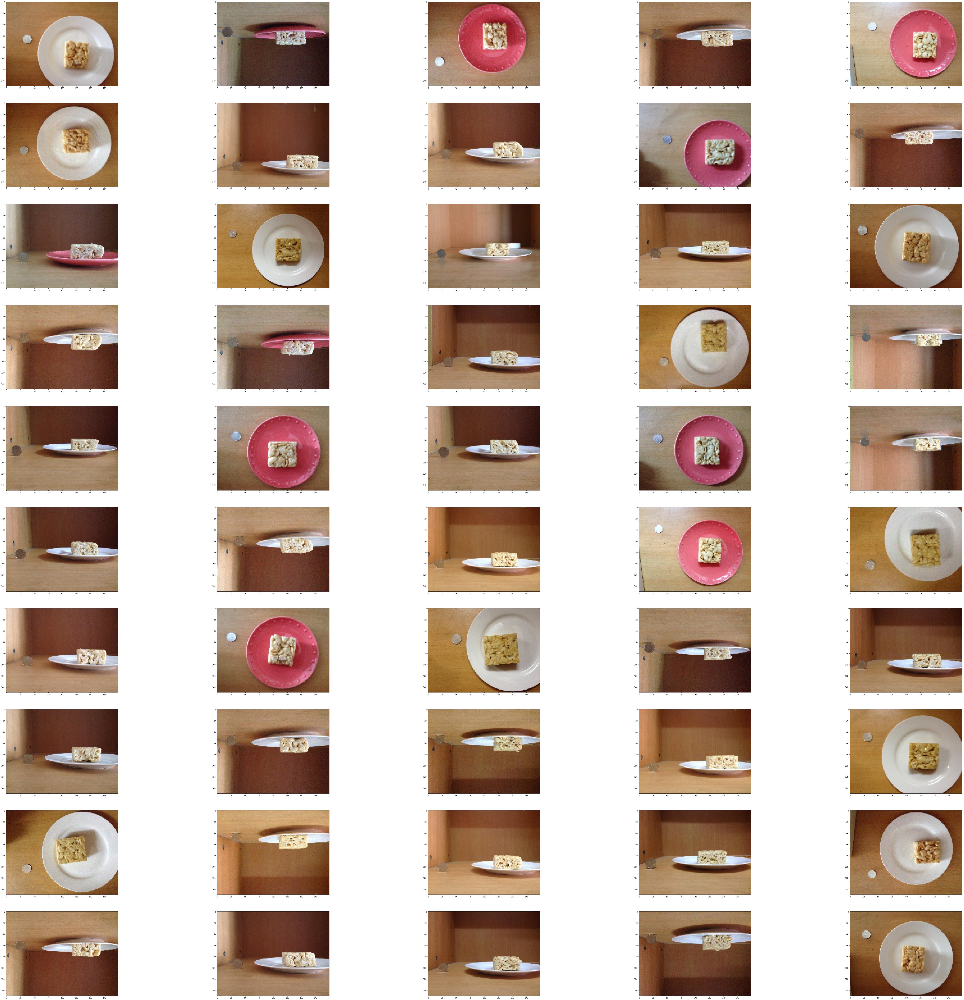

In [252]:
showRandImgs(inDF,'ProdName','SKImage','SACHIMA')

Pear:

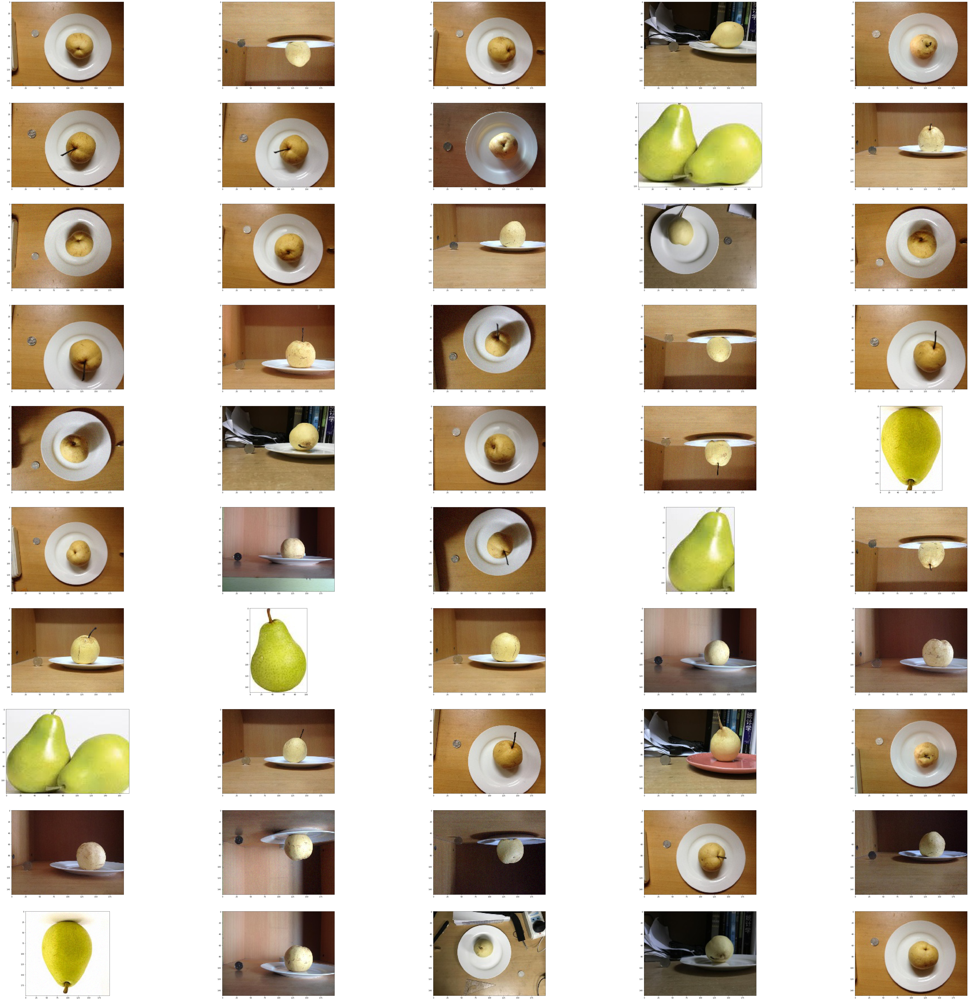

In [253]:
showRandImgs(inDF,'ProdName','SKImage','PEAR')

Both classes represent items of similar color. Since most of features used for training are related to color or texture, it is not suprising, that algorithms can be unable to differentiate those classes properly. 

Orange, Tomato and Apple:

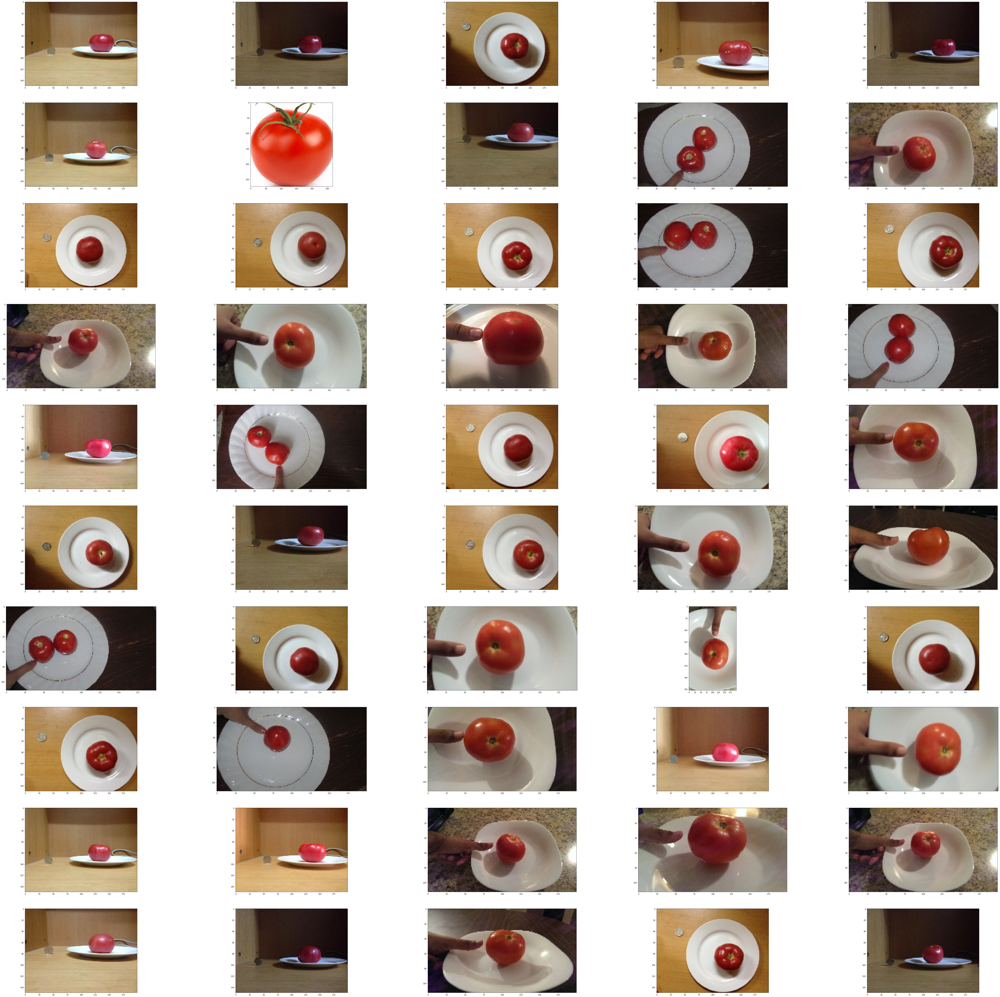

In [255]:
showRandImgs(inDF,'ProdName','SKImage','TOMATO')

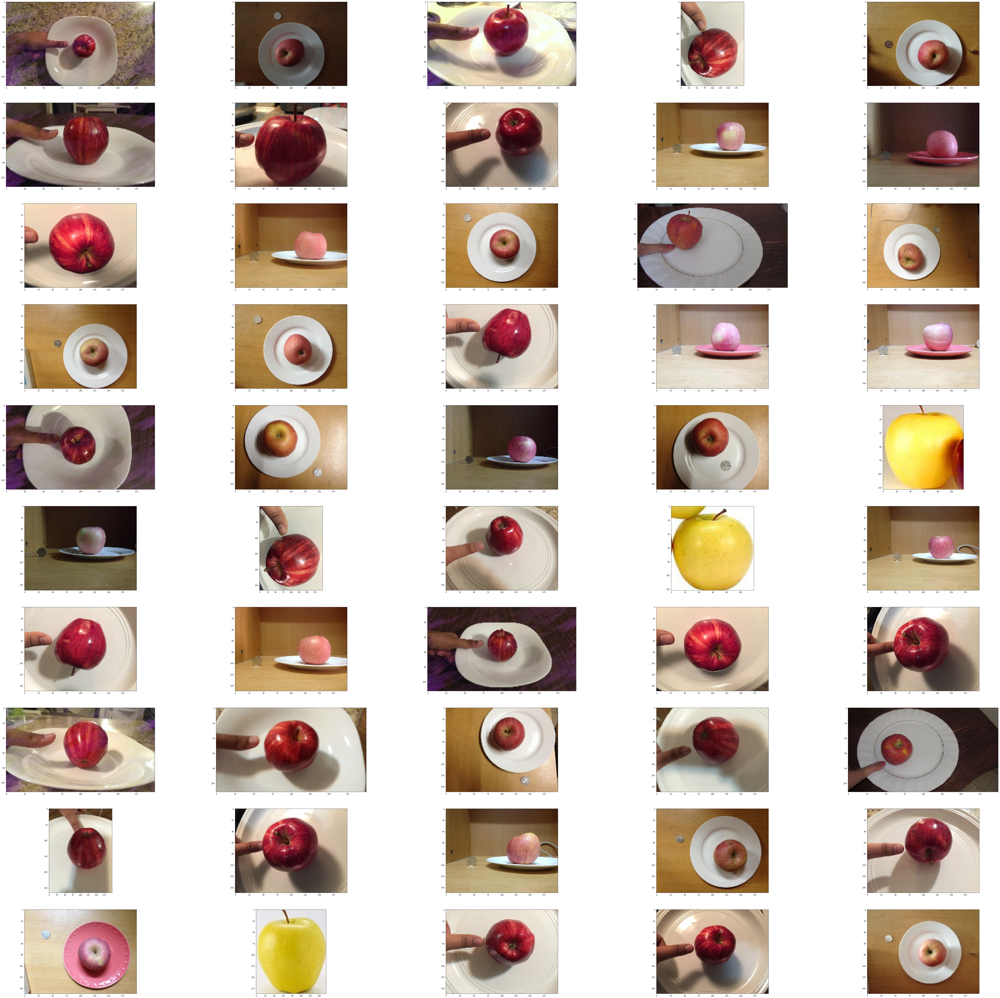

In [256]:
showRandImgs(inDF,'ProdName','SKImage','APPLE')

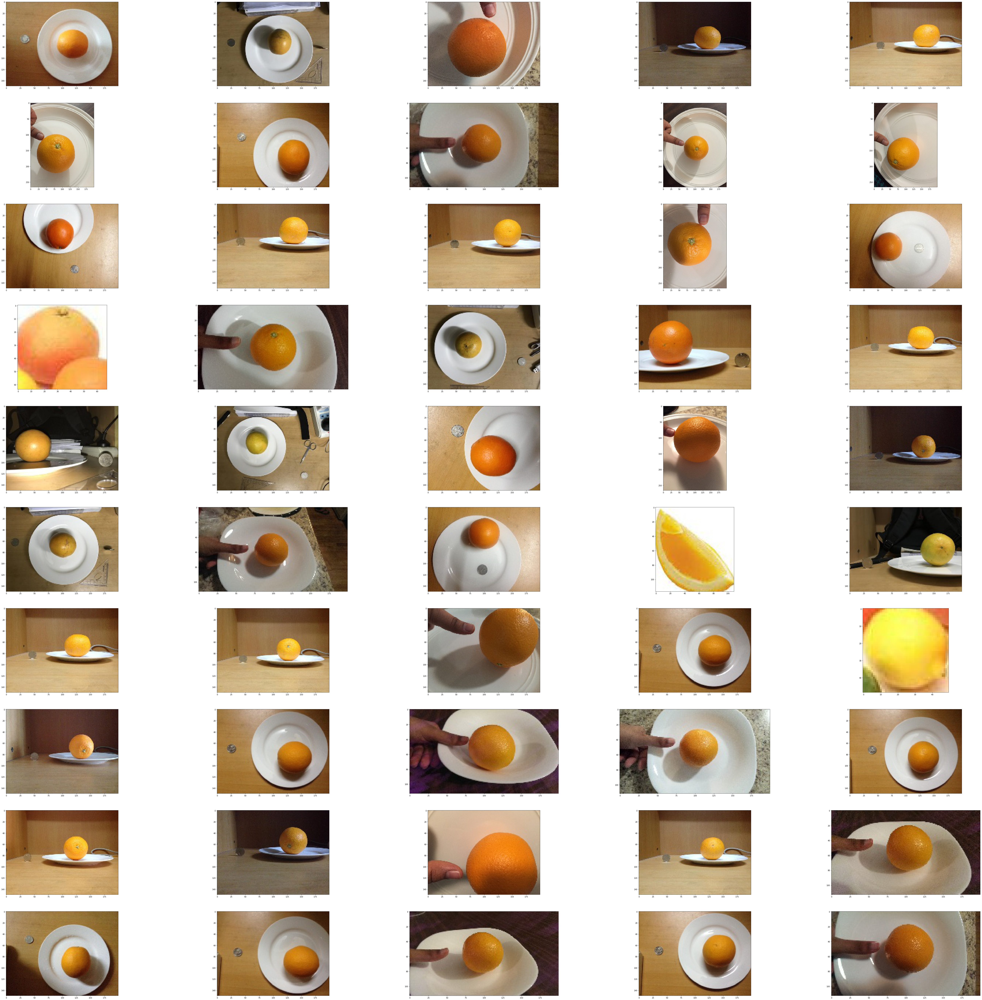

In [257]:
showRandImgs(inDF,'ProdName','SKImage','ORANGE')

Those classes are very similar, both in shape and color. Difficulties in differentiating them are not surprising.

## Future Work <a name="future_work"></a>
There are some improvements which will be done in the future:
* More thorough parameters searching, probably in proximity of current best models.
* Adding more plots
* Best results have been achieved by sklearn Neural Network Classifier, hence it can be assumed, that neural network written in Keras would perform even better. Module written in Keras will be attached to this project.

## References <a name="references"></a>
[1] http://www.site.uottawa.ca/~shervin/food/ "FooDD Database" <a name="foodd"></a>

[2] https://github.com/Liang-yc/ECUSTFD-resized- "EcustFD Database" <a name="ecustfd"></a>

[3] https://github.com/OlafenwaMoses/ImageAI/blob/master/README.md "ImageAI Project" <a name="imgai"></a>